In [1]:
%load_ext autoreload
%autoreload 2

In [60]:
import numpy as np
import h5py
import matplotlib.pyplot as plt
import scipy as sc
import scipy.ndimage as scimg
from scipy.optimize import minimize
from matplotlib import pyplot as plt
import matplotlib.colors as colors
from scipy.ndimage import gaussian_filter as gf

from matplotlib import cm
from matplotlib.colors import ListedColormap
from scipy.interpolate import interp1d
import sys
sys.path.append('/reg/neh/home/tdd14/modules/cart2pol/cart2pol')
import cart2pol
import scipy.misc as scmis
from scipy.optimize import curve_fit
import scipy.special as sp
from datetime import datetime
# sys.path.append('/reg/d/psdm/tmo/tmox51020/results/paris/recon')
# from recon_funcs import *
from torchrecon_funcs_cal import *
sys.path.append('/reg/neh/home/tdd14/modules/cart2pol/cart2pol')
import cart2pol
from cart2pol import PolarRebin

In [3]:
mfn = 25
gfn = 15
gfsig = 0.985
basesdir = '/reg/d/psdm/tmo/tmox51020/results/paris/circularpol_vNbases_dipole_Feb/' #'/reg/d/psdm/tmo/tmox51020/results/paris/circularpol_vNbases_dipole_K5/'
PR = PolarRebin('/reg/d/psdm/tmo/tmox51020/results/paris/recon/PR_c32_r32_th32.h5')

In [190]:
Ups = [0.1,0.2,0.3,0.5,1.0] #[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 1.0] #[0, 0.1, 0.5, 1.0] #,0.2,0.5,1.0]
Bps = []
alphas = []
vNaxiss = []
alphaws = []
alphats = []
N_w = 6
N_t = 6
Nb = N_w*N_t
for i in range(len(Ups)):
    Np = 128
    Up = Ups[i]  
    filename = 'Bpbasis_Np' + str(Np) + '_Nw' + str(N_w) +'_Nt' + str(N_t) + '_Up' + str(Up)+'.npy'
    print(filename)
    br = np.load(basesdir+filename, allow_pickle=True)
    Breal = br[()]['Breal']
    Bimag = br[()]['Bimag']
    breal = br[()]['breal']
    bimag = br[()]['bimag']
    vNaxis = br[()]['vNaxis']
    alpha = br[()]['alpha']

    
    tempr = np.zeros((Breal.shape[0], 64**2))
    tempi = np.zeros((Breal.shape[0], 64**2))
    for i in range(len(Breal)):
        tempr[i,:] = np.reshape(rebin(np.reshape(Breal[i,:], [128,128])), [64**2])
        tempi[i,:] = np.reshape(rebin(np.reshape(Bimag[i,:], [128,128])), [64**2])

    Breal = tempr
    Bimag = tempi
    
    
    alphw = np.zeros(alpha['t_sample'].shape, dtype = complex)
    alpht = np.zeros(alpha['t_sample'].shape, dtype = complex)
    for i in range(len(alphw)):
        f = interp1d(vNaxis['t_sample'], alpha['t_sample'][i], fill_value = 0, bounds_error = False)
        N = 2801 #1024
        ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], N)
        a = f(ts)
        #a = f(vNaxis['t_sample'])
        alpht[i] = a
        alphw[i] = np.fft.ifftshift(np.fft.ifft(a))

    # alphw = np.zeros(alpha['t_sample'].shape, dtype = complex)
    # for i in range(len(alphw)):
    #     alphw[i] = np.fft.ifftshift(np.fft.ifft(alpha['t_sample'][i]))

    Np = 64
    for j in range(Breal.shape[0]):
        temp=np.reshape(Breal[j,:],[Np,Np])
        polimg = PR.cart2pol(temp,32,32)
        bb = np.zeros((64,64))
        bb[1:64,1:64]= PR.pol2cart(scimg.filters.gaussian_filter(polimg,[gfsig,0]))
        Breal[j,:]=np.reshape(bb,newshape=(1,Np**2))
        #temp=scimg.filters.gaussian_filter(temp,0.8889)
        #Bpr[j,:]=Variable(Tensor(np.reshape(temp,newshape=(1,Np**2))))
        temp=np.reshape(Bimag[j,:],[Np,Np])
        polimg = PR.cart2pol(temp,32,32)
        bb = np.zeros((64,64))
        bb[1:64,1:64]= PR.pol2cart(scimg.filters.gaussian_filter(polimg,[gfsig,0]))
        Bimag[j,:]=np.reshape(bb,newshape=(1,Np**2))
        #temp=scimg.filters.gaussian_filter(temp,0.8889)
        #Bpi[j,:]=Variable(Tensor(np.reshape(temp,newshape=(1,Np**2))))

    Bp_basis = Breal+1j*Bimag

    Bps.append(Bp_basis)
    alphas.append(alpha)
    vNaxiss.append(vNaxis)
    alphaws.append(alphw)
    alphats.append(alpht)

Bpbasis_Np128_Nw6_Nt6_Up0.1.npy
Bpbasis_Np128_Nw6_Nt6_Up0.2.npy
Bpbasis_Np128_Nw6_Nt6_Up0.3.npy
Bpbasis_Np128_Nw6_Nt6_Up0.5.npy
Bpbasis_Np128_Nw6_Nt6_Up1.0.npy


In [5]:
def FWHM(t, spec): 
    peakMax = np.max(spec)
    indMax = np.where(spec == peakMax)[0] #should be center since rolled
    if len(indMax)>1: indMax = np.max(indMax)
    t1 = 0
    t2 = 0
    
    for i in range(int(len(t)/2)):
        if t2 != 0 and t1 != 0:
            break
        if i < indMax: 
            if spec[i] >= 0.5*peakMax and t1 == 0:
                t1 = t[i]
            if spec[-i] >= 0.5*peakMax and t2 == 0:
                t2 = t[-i]  
    return t2-t1

-30


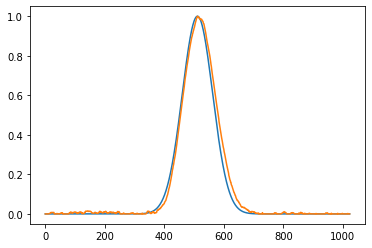

In [6]:
x = np.linspace(-10,10,1024)
sig = 1
sss = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(x-0)**2/sig**2))
sss = sss/np.max(sss)
plt.plot(sss)
#sss = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Feb3_110.npy')
sss = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Dec16.npy')
sss = np.mean(sss,axis = 0)
sss = sss/np.max(sss)
sss[sss<0] = 0
rollnum = np.argmax(sss)-512
sss = np.roll(sss,-rollnum)
plt.plot(sss)
print(rollnum)

In [17]:
def make_SASE(xeV):
    sss = np.zeros(len(xeV))
    for i in range(int(xeV[-1])):
        sig = xeV[-1]*0.05*np.random.rand()
        amp = np.random.rand()
        s = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(xeV-i+1)**2/sig**2))
        sss = sss+s/np.max(s)*amp
        sig = xeV[-1]*0.05*np.random.rand()
        amp = np.random.rand()
        s = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(xeV+i+2)**2/sig**2))
        sss = sss+s/np.max(s)*amp
    return sss/np.max(sss)
plt.plot(xeV,make_SASE(xeV))

NameError: name 'xeV' is not defined

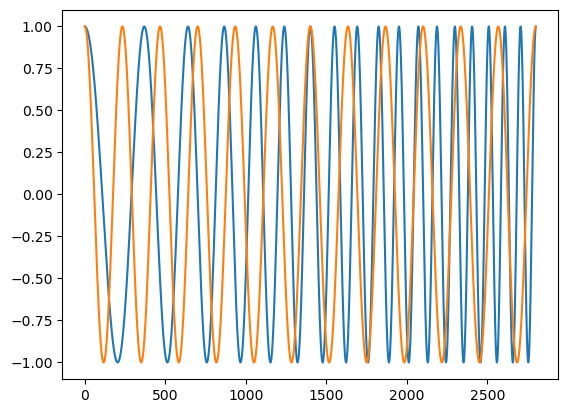

In [32]:
w0 = np.ones(len(ts))*i + np.linspace(0,i,len(ts))
car3 = np.exp(-1.j*(w0)/hbar*ts) 
plt.plot(car3)
w0 = np.ones(len(ts))*i + np.linspace(0,0,len(ts))
car3 = np.exp(-1.j*(w0)/hbar*ts) 
plt.plot(car3)

/tmp/ipykernel_1136/4020387029.py:32: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(3.25381312539921e-17)))[0] #t[1]-t[0]
/cds/sw/ds/ana/conda2/inst/envs/ps-4.5.26/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


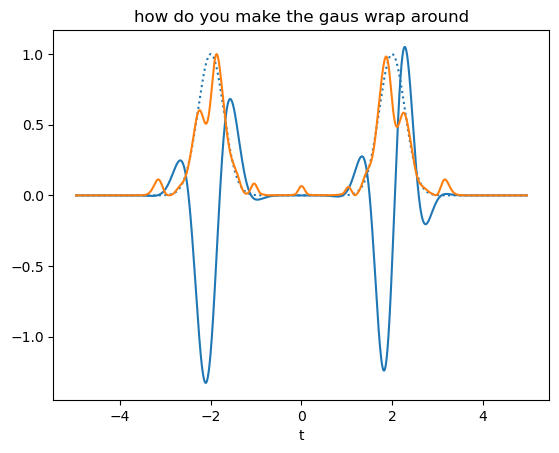

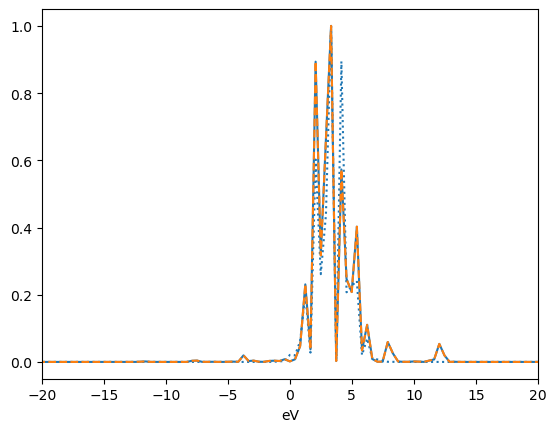

In [20]:
sss = np.zeros(len(ts))
w0s = [3,2]
chirps1 = [0,2]
chirps2 = [0,0]
sigs = [0.4, 0.9]
t0s = [-2,2]
amp = [4,4]
for i in range(len(w0s)):
    #w0 = i
   
    w0 = np.ones(len(ts))*w0s[i] + np.linspace(0,chirps1[i],len(ts)) + (np.linspace(0,chirps2[i],len(ts)))**2
    ###NEED TO CENTER CHIRP AROUND t0####
    sig = sigs[0]

    
    car3 = np.exp(-1.j*(w0)/hbar*ts) 
    
    ### how to add in the second order phase?
    #Ew_in = Ew0*np.exp(1j*(self.a1*((xeV-self.w0))+self.a2*((xeV-self.w0))**2+self.a3*((xeV-self.w0))**3)) #add in the phase


    s = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(ts*1e15-t0s[i])**2/sig**2))
    sss = sss+(s/np.max(s))*amp[i]*car3


Et = sss #add in the frequency due to offset from zero frequency
f = interpolate.interp1d(ts, Et, fill_value = 0, bounds_error = False) #fill_value = 'extrapolate')
x = f(vNaxis['t_sample'])
alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha


Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(3.25381312539921e-17)))[0] #t[1]-t[0]

Et = np.squeeze(np.matmul(Qs.T,alpht))

plt.plot(ts*1e15,sss/np.max(sss))
plt.plot(ts*1e15,sss*np.conj(sss)/np.max(sss*np.conj(sss)), ':', color ='tab:blue')
plt.plot(ts*1e15,Et*Et.conj()/np.max(np.abs(Et)**2), 'tab:orange')
plt.xlabel('t')
plt.title('how do you make the gaus wrap around')
plt.show()

FFT = np.fft.ifftshift(np.fft.ifft(Et))
plt.plot(eV,FFT*FFT.conj()/np.max(np.abs(FFT)**2), 'tab:blue')

FFT = np.fft.ifftshift(np.fft.ifft(sss))
plt.plot(eV,FFT*FFT.conj()/np.max(np.abs(FFT)**2), ':', color = 'tab:blue')


Ew = np.squeeze(np.matmul(Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), '--', color= 'tab:orange')


plt.xlim(-20,20)
plt.xlabel('eV')
plt.show()



(-20.0, 20.0)

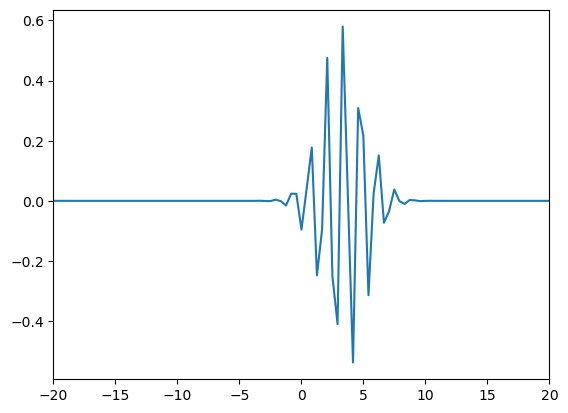

In [167]:
plt.plot(eV,FFT)
plt.xlim(-20,20)

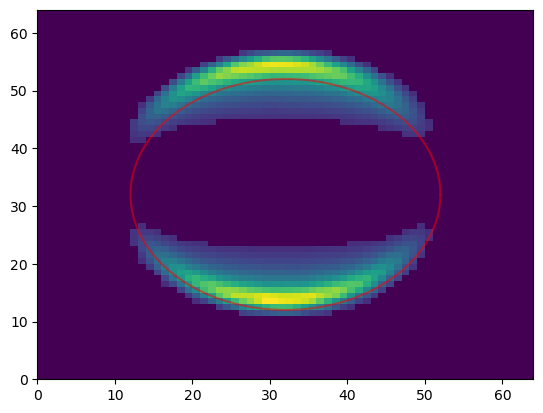

In [158]:
Msol1=np.real(np.matmul(np.matmul(Qs,Qs.conj().transpose()).transpose().flatten(),Bp_basis))
Msol1 = np.reshape(Msol1,[64,64])
Msol1 = Msol1*250/np.max(Msol1)
Msol1[Msol1<32] = 0 
plt.pcolormesh(Msol1)
phis = np.linspace(0,2*np.pi,100)
plt.plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'r-', alpha = 0.5)

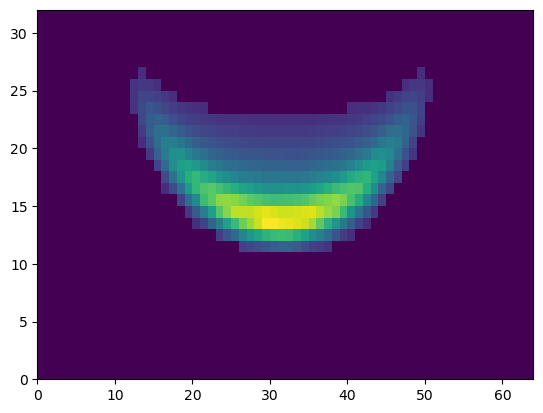

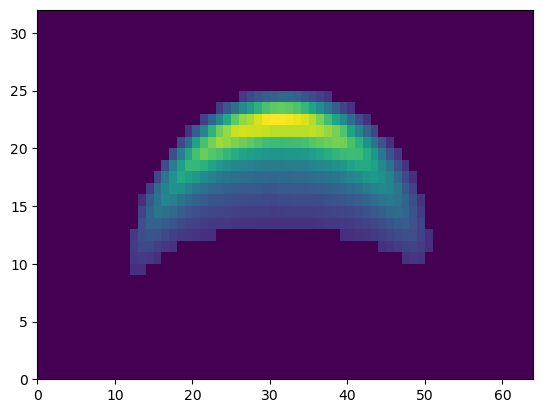

(37042.161985773375, 37610.9429929676)

In [159]:
plt.pcolormesh(Msol1[:32,:])
plt.show()
plt.pcolormesh(Msol1[32:,:])
plt.show()
np.sum(Msol1[:32,:]),np.sum(Msol1[32:,:])

/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/ipykernel/__main__.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


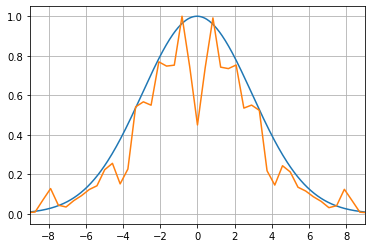

In [7]:
class Point():
    def __init__(self,spec, pixpereV, w0, a1, a2, a3):
        self.pixpereV = pixpereV
        self.spec = spec
        self.Ewin = None
        self.xeV = None #goes with spec
        self.w0 = w0
        self.a1 = a1
        self.a2 = a2
        self.a3 = a3
        self.Qs = None
        self.eV = None #goes with Ew
        self.tpreQ = None
        
    def make_Qs(self):
        '''
        spec - spectra profile with w0 at pix 512 ALREADY ROLLED
        w0 - where to shift center eV to
        a1,a2,a3 1st, 2nd, 3rd order chirps
        '''
        spec = self.spec
        spec[spec<0] = 0
        Ew0 = np.sqrt(spec)

        #make corresponding spectrum frequency axis in eV
        xeV = pix_2_eV(np.arange(len(Ew0)), pixpereV = self.pixpereV, spectra_hw0 = 0, spectra_pix0 = 512)
        #self.xeV = xeV
        xeV = xeV + self.w0

        # n1 = 2 #254 # spans range of vNaxis['w'] and centered around zero, in this case pix 512
        # n2 = -n1+1 
        # xeV = xeV[n1:n2] 
        # Ew0 = Ew0[n1:n2]
        
        n1 = 1# I do not know why this works
        xeV = xeV[n1:] 
        Ew0 = Ew0[n1:] 

        f = interp1d(xeV, Ew0, fill_value = 0, bounds_error = False)
        NN = 512*2 #how many points you want to use for the FFT, power of 2
        N = len(Ew0) #current length
        fx = interp1d(np.arange(N), xeV,fill_value = 0, bounds_error = False)
        xeV = fx(np.linspace(0, N-1, NN)) #make sure your points are evenly spaced for the FFT and you have the number of points you want
        Ew0 = f(xeV)

       # Ew_in = Ew0*np.exp(1j*(self.a1*(np.pi*2*(xeV-self.w0))+self.a2*(np.pi*2*(xeV-self.w0))**2+self.a3*(np.pi*2*(xeV-self.w0))**3)) #add in the phase
        Ew_in = Ew0*np.exp(1j*(self.a1*((xeV-self.w0))+self.a2*((xeV-self.w0))**2+self.a3*((xeV-self.w0))**3)) #add in the phase
        self.Ewin = Ew_in
        xf = 2.9979E8*xeV/1239.84e-9
        #f = np.abs(xf[-1])*2
        f = xf[-1] - xf[0]
        

        N = len(Ew_in) #this should be N = NN now
        #t = np.linspace(-N/f/2+1/f/2,N/f/2+1/f/2, N) 
        t = np.linspace(-N/f/2,N/f/2, N) 
        FFT = np.fft.fftshift(np.fft.fft(np.fft.fftshift(Ew_in))) #shift so central frequency is at 0
        car3 = np.exp(-1.j*(self.w0)/hbar*t)
        FFT = FFT*car3 #add in the frequency due to offset from zero frequency
        f = interp1d(t, FFT, fill_value = 0, bounds_error = False) #fill_value = 'extrapolate')
        x = f(vNaxis['t_sample'])
        self.tpreQ = x*x.conj()
        alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

        self.Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]
        #print(t[1]-t[0])#*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]) is just a scalar, doesn't need to be evenly spaced?    
    
    def pix_2_eV(pixel, pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512):
        '''
        pixel: array of pixel indices
        pixpereV: calibration pixels per eV
        spectral_hw: (optional) central energy if you have absolutes
        spectra_pix0: where to put w = 0, 512 is at the center for 1024pix spectrometer 
        '''
        spectra_dhwdpix = 1./pixpereV
        spectra_hws_eV = spectra_hw0 + spectra_dhwdpix*(pixel -spectra_pix0)
        return spectra_hws_eV


def gaus(x, a, mu, sig):
    return a*1/sig/np.sqrt(2*np.pi)*np.exp(-0.5*((x-mu)/sig)**2)

w0 = 0
a1 = 0
a2 = 0
a3 = 0.005
#p1 = Point(sss, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
sg = gaus(np.linspace(-11,11,1024), 1, 0, 1.4)
p1 = Point( sg/np.max(sg), pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
p1.make_Qs()
xeV = pix_2_eV(np.arange(len(p1.spec)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
plt.plot(xeV+w0, p1.spec)
Ew = np.squeeze(np.matmul(p1.Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-9,9)
plt.grid()

-23.227272727272727 23.227272727272727
1023
-23.227272727272727 23.227272727272727
-5616292498152254.0 5616292498152254.0


/tmp/ipykernel_30517/1900886185.py:51: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(ts[1] - ts[0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]


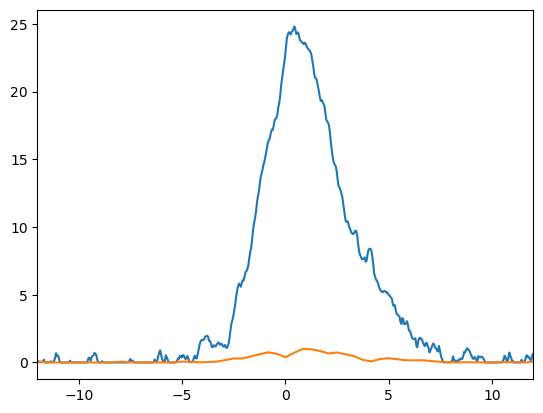

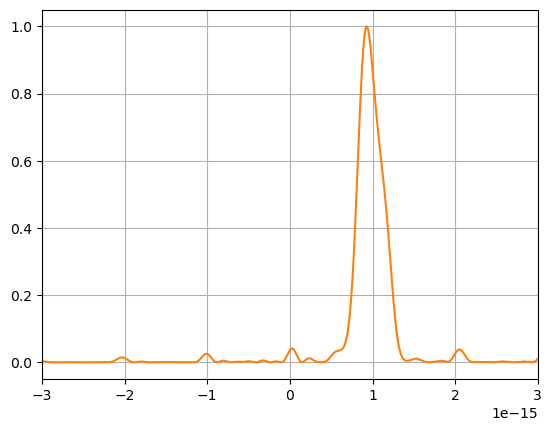

In [466]:
a1 = 1.81 #0.47 #.35
a2 = 0.01
a3 = 0 #-12e-3
w0 = 0
ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], 2801) #corresponds with alphats

spec = sss[0]
spec[spec<0] = 0
Ew0 = np.sqrt(spec)

#make corresponding spectrum frequency axis in eV
xeV = pix_2_eV(np.arange(len(Ew0)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
#self.xeV = xeV
xeV = xeV + w0


# n1 = 2# 254 # spans range of vNaxis['w'] and centered around zero, in this case pix 512
# n2 = -n1+1 
# xeV = xeV[n1:n2] 
# Ew0 = Ew0[n1:n2] 
n1 = 1# 254 # spans range of vNaxis['w'] and centered around zero, in this case pix 512
#n2 = -n1+1 
xeV = xeV[n1:] 
Ew0 = Ew0[n1:] 

print(xeV[0],xeV[-1])

f = interpolate.interp1d(xeV, Ew0, fill_value = 0, bounds_error = False)
NN = 512*2 #how many points you want to use for the FFT, power of 2
N = len(Ew0) #current length
print(N)
fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
xeV = fx(np.linspace(0, N-1, NN)) #make sure your points are evenly spaced for the FFT and you have the number of points you want
print(xeV[0],xeV[-1])
Ew0 = f(xeV)
Ew_in = Ew0*np.exp(1j*(a1*((xeV-w0))+a2*((xeV-w0))**2+a3*((xeV-w0))**3)) #add in the phase
plt.plot(xeV, Ew_in*Ew_in.conj())
plt.xlim(-12,12)

xf = 2.9979E8*xeV/1239.84e-9
print(xf[0],xf[-1])
f = xf[-1] - xf[0] #need full range, not centered at zero
N = len(Ew_in)  #now 1024 
t = np.arange(-N/2, N/2)/f
FFT = np.fft.fftshift(np.fft.fft(np.fft.fftshift(Ew_in))) #shift so central frequency is at 0
car3 = np.exp(-1.j*(w0)/hbar*t)
FFT = FFT*car3 #add in the frequency due to offset from zero frequency
f = interpolate.interp1d(t, FFT, fill_value = 0, bounds_error = False) #fill_value = 'extrapolate')
x = f(ts)
alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha
Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(ts[1] - ts[0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0] 

N = len(vNaxis['t_sample'])
#xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
xf = np.arange(-N/2-1/2,N/2-1/2,1)/(np.abs(ts[0])*2)
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9  #this should not actually be evenly spaced?
Ew = np.squeeze(np.matmul(Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
plt.show()

Et = np.squeeze(np.matmul(Qs.T,alpht))
plt.plot(ts,Et*Et.conj()/np.max(np.abs(Et)**2), 'tab:orange')
plt.xlim(-3e-15,3e-15)
plt.grid()

In [28]:
1239.84*(2*np.pi*(vNaxis['w'][-1]/2/np.pi))/2.9979E8/(2*np.pi)*1e-9 

11.736431718419107

/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/ipykernel/__main__.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


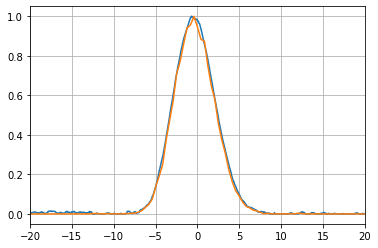

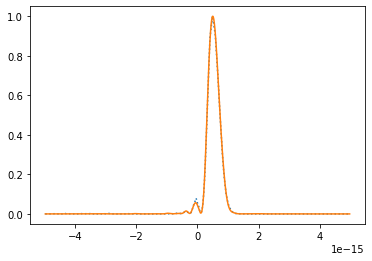

In [24]:
w0 = -.7
a1 = 0.9
a2 = 0.0
a3 = -0.01
#p1 = Point(sss, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
sg = gaus(np.linspace(-11.736,11.736,1024), 1, 0, .4)
s1 = sss # sg/np.max(sg)
p1 = Point(s1, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
p1.make_Qs()
xeV = pix_2_eV(np.arange(len(sss)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
plt.plot(xeV+w0, p1.spec)
Ew = np.squeeze(np.matmul(p1.Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-20,20)
plt.grid()
plt.show()

Et = np.squeeze(np.matmul(p1.Qs.T,alpht))
plt.plot(vNaxis['t_sample'], p1.tpreQ/np.max(p1.tpreQ), ':')
plt.plot(ts, Et*Et.conj()/np.max(np.abs(Et)**2))

(-11, 11)

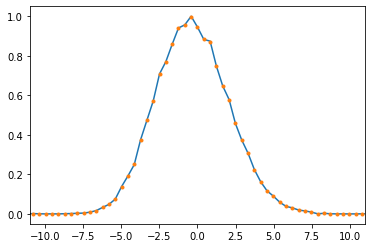

In [26]:
N = 2801
eshift = 0
f = interp1d(eV, Ew*Ew.conj()/np.max(np.abs(Ew)**2), fill_value = 0, bounds_error = False) 
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2))
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
spec = np.real(f(xeV))
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
#Interpolate spec outside of the loop to match eV
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
xeV = xeV - eshift #2.5 #3 #know this from previous calibration
f = interp1d(xeV,spec, bounds_error=False, fill_value = 0)
spec_in = f(eV[1340:-1340])
plt.plot(eV[1340:-1340], spec_in, '.')
plt.xlim(-11,11)

In [45]:
for a1 in a1s:
    for a2 in a2s:
        for a3 in a3s:
            #a3 = a3*(0.0005-a2)/10
            a3 = a3*(np.max(a2s)-np.abs(a2))/100
            for w0 in ees:
                print([a1,a2,a3,w0])

[2.0, -0.1, -0.028999999999999998, 0]
[2.0, -0.1, -0.014499999999999999, 0]
[2.0, -0.1, 0.0, 0]
[2.0, -0.1, -0.014499999999999999, 0]
[2.0, -0.1, 0.028999999999999998, 0]
[2.0, 0.675, -0.023250000000000003, 0]
[2.0, 0.675, -0.011625000000000002, 0]
[2.0, 0.675, 0.0, 0]
[2.0, 0.675, -0.011625000000000002, 0]
[2.0, 0.675, 0.023250000000000003, 0]
[2.0, 1.45, -0.0155, 0]
[2.0, 1.45, -0.00775, 0]
[2.0, 1.45, 0.0, 0]
[2.0, 1.45, -0.00775, 0]
[2.0, 1.45, 0.0155, 0]
[2.0, 2.225, -0.007749999999999999, 0]
[2.0, 2.225, -0.0038749999999999995, 0]
[2.0, 2.225, 0.0, 0]
[2.0, 2.225, -0.0038749999999999995, 0]
[2.0, 2.225, 0.007749999999999999, 0]
[2.0, 3.0, -0.0, 0]
[2.0, 3.0, -0.0, 0]
[2.0, 3.0, 0.0, 0]
[2.0, 3.0, -0.0, 0]
[2.0, 3.0, 0.0, 0]
[2.25, -0.1, -0.028999999999999998, 0]
[2.25, -0.1, -0.014499999999999999, 0]
[2.25, -0.1, 0.0, 0]
[2.25, -0.1, -0.014499999999999999, 0]
[2.25, -0.1, 0.028999999999999998, 0]
[2.25, 0.675, -0.023250000000000003, 0]
[2.25, 0.675, -0.011625000000000002, 0]
[2.2

In [48]:
np.hstack((np.linspace(-10,6,5)*1e-3,[0]))

array([-0.01 , -0.006, -0.002,  0.002,  0.006,  0.   ])

In [8]:
def two_peaks(t, spec): 
    spec[spec<0] = 0
    spec = spec/np.max(spec)
    peakMax = np.max(spec)
    indMax = np.where(spec == peakMax)[0] 
    if len(indMax)>1: indMax = np.max(indMax)
    else: indMax = indMax[0]
    rollnum =  int(len(spec)/2) - indMax
    spec = np.roll(spec, rollnum)
    indMax = int(len(spec)/2)
    t1 = 0
    t2 = 0
    ind1 = 0
    ind2 = 0
    
    for i in range(int(len(t))):
        if t2 != 0 and t1 != 0:
            break
        if i < indMax:
            #print(i, np.trapz(spec[-i:]))
            
            if (spec[indMax-i] <= 0.5) & (t1 == 0):
                t1 = t[indMax-i]
                ind1 = indMax-i
            elif (spec[indMax+i] <= 0.5) & (t2 == 0):
                t2 = t[indMax+i]  
                ind2 = indMax+i
                
    spec = spec/np.sum(spec)
    area = np.trapz(spec[ind1:ind2]) #area in the FWHM
    return t2-t1, area, ind1-rollnum, ind2-rollnum

In [9]:
sss = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Feb3_110.npy')
areas = []
for i in range(len(sss)):
    fw, area, ind1, ind2 = two_peaks(xeV,sss[i])
    areas.append(area)

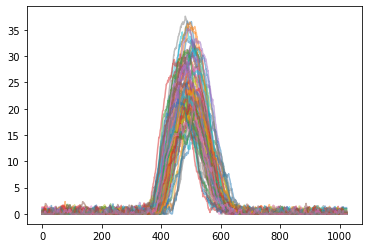

In [10]:
for n in np.where((0.72<np.array(areas)))[0]:
    plt.plot(sss[n], alpha = 0.5)
cut = (0.72<np.array(areas))

In [11]:
a1s = np.linspace(1.75, 2.9, 4)
#a2s = np.linspace(-0.0005, 0.0005, 3)
a2s = [-0.14, 0, 0.14, 0.2, 0.3]
a3s = [-1,1]
for a1 in a1s:
    for a2 in a2s:
        for a3 in a3s:
            #a3 = a3*(0.0005-a2)/10
            a3 = a3*(np.max(a2s)-np.abs(a2))/10*np.random.rand()
            print(a1,a2,a3)

1.75 -0.14 -0.006780552359986153
1.75 -0.14 0.012848623234095012
1.75 0 -0.0019355421494198076
1.75 0 0.024761210531947686
1.75 0.14 -0.0099436761144485
1.75 0.14 0.009736852049852444
1.75 0.2 -0.0037003945021490776
1.75 0.2 0.006164393981543019
1.75 0.3 -0.0
1.75 0.3 0.0
2.1333333333333333 -0.14 -0.011440897749789895
2.1333333333333333 -0.14 0.011094628042302405
2.1333333333333333 0 -0.014916847827069545
2.1333333333333333 0 0.006200027816493721
2.1333333333333333 0.14 -0.010932190719107643
2.1333333333333333 0.14 0.005037417700452919
2.1333333333333333 0.2 -0.009893174019220895
2.1333333333333333 0.2 0.00804185398544104
2.1333333333333333 0.3 -0.0
2.1333333333333333 0.3 0.0
2.5166666666666666 -0.14 -0.009379326422564963
2.5166666666666666 -0.14 0.002572218837803205
2.5166666666666666 0 -0.006260904262136166
2.5166666666666666 0 0.028959748938581647
2.5166666666666666 0.14 -0.0022214614608309867
2.5166666666666666 0.14 6.603640625277228e-05
2.5166666666666666 0.2 -0.003532436349639623

/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/ipykernel/__main__.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


NameError: name 'interpolate' is not defined

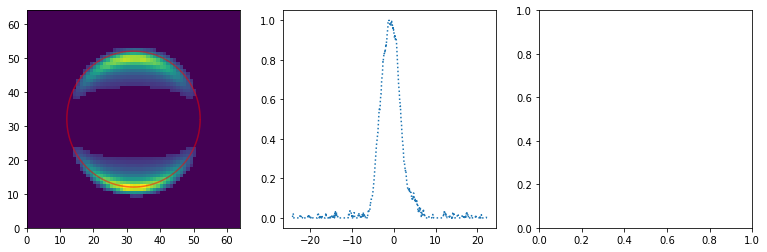

In [12]:
specs = []
ms = []
trueQs = []
trueUps = []

a1s = np.linspace(1.75, 2.9, 4)
#a2s = np.linspace(-0.0005, 0.0005, 3)
a2s = [-0.14, 0, 0.14, 0.2]
#a2s = [-0.14, 0, 0.14, 0.2, 0.3] #np.hstack((np.linspace(-0.12, 0.3, 3),[0]))
#a3s = [-0.01, -0.005, 0, 0.002, 0.006] #np.hstack((np.linspace(-10,6,5)*1e-3,[0]))
a3s = [-1,0,1]
ees = [-1,0,1]
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
xeV = pix_2_eV(np.arange(len(sss[0])), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], N)
phis = np.arange(0,360)*np.pi/180


n = 0

for a1 in a1s:
    a1 = a1-np.random.rand()*0.25
    for a2 in a2s:
        for a3 in a3s:
            #a3 = a3*(0.0005-a2)/10
            a3 = a3*(np.max(a2s)-np.abs(a2))/10*np.random.rand()
            for w0 in ees:
                s = sss[cut][n]
                s = s/np.max(s)
                s[s<0] = 0
                s = np.roll(s,21)

                for u in range(len(Ups)):
                    Bp_basis = Bps[u]
                    alphw = alphaws[u]
                    alpht = alphats[u]

                    p1 = Point(s, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
                    p1.make_Qs()
                    Q = p1.Qs
                    fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (13,4))
                    Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
                    Msol1 = np.reshape(Msol1,[64,64])
                    Msol1 = Msol1*250/np.max(Msol1)
                    Msol1[Msol1<32] = 0 
                    axs[0].pcolormesh(Msol1)
                    axs[0].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'r-', alpha = 0.5)
                    axs[1].plot(xeV+w0, p1.spec, ':')
                    Ew = np.squeeze(np.matmul(Q.T,alphw))
                    EwEw = Ew*Ew.conj()/np.max(np.abs(Ew)**2)
                    f = interpolate.interp1d(eV, EwEw, fill_value = 0, bounds_error = False)
                    EwEw = f(xeV)
                    axs[1].plot(xeV, EwEw)
                    Et = np.squeeze(np.matmul(Q.T,alpht))
                    axs[2].plot(vNaxis['t_sample'], p1.tpreQ/np.max(p1.tpreQ), ':')
                    axs[2].plot(ts, Et*Et.conj()/np.max(np.abs(Et)**2))
                    axs[1].set_xlim(-10,10)
                    axs[2].set_xlim(-3.2e-15,3.2e-15)
                    axs[2].grid()
                    duration = FWHM(ts[t1:t2]*1e15,np.roll(EtEt[t1:t2], int(len(EtEt[t1:t2])/2)-roll_to))
                    axs[2].set_title('%1.3f fs' %duration)
                    plt.suptitle('a1 = %1.4f, a2 = %1.4f, a3= %1.4f, w0 = %1.2f, Up = %1.2f' %(a1,a2,a3,w0,Ups[u]))
                    specs.append(np.real(EwEw))
                    ms.append(Msol1)
                    trueQs.append(Q)
                    trueUps.append(Ups[u])

            n = n+1
            if n > 2: break

In [21]:
len(specs)

270

In [22]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jul5_long.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jul5_long.npy', ms)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Qs_Jul5_long.npy', trueQs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ups_Jul5_long.npy', trueUps)

In [8]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Mar7_long.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Mar7_long.npy', ms)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Qs_Mar7_long.npy', trueQs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ups_Mar7_long.npy', trueUps)

In [289]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Feb22_0.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Feb22_0.npy', ms)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Qs_Feb22_0.npy', trueQs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ups_Feb22_0.npy', trueUps)

0.0

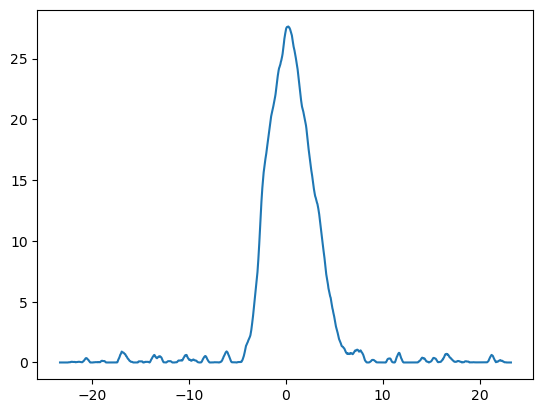

In [86]:
s2 = np.roll(sss[cut][23],512-np.argmax(sss[cut][23]))
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
plt.plot(xeV,fastsmooth1(s2,10))
xeV[np.argmax(s2)]

/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/ipykernel/__main__.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


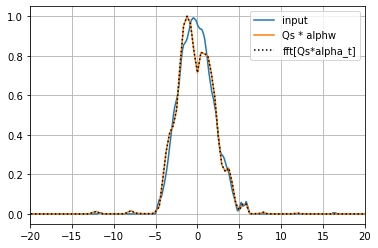

(-3.9e-15, 3.9e-15)

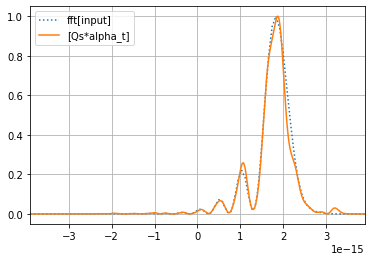

In [172]:
# ees = [0, 1, -1, 1, 0.5, 0.3, 0.8, -0.4, 1, 0.6, 0.2, 1.2, 1, 0.9]
# a1s = [1.79, 1.89, 2, 2.47, 1.67, 2.68, 2.6, 2.38, 2.22, 2.13, 2.36, 2.8, 2.78, 2.33]
# a2s = [-0.154, -0.0849, 0.077, 0.07, -0.11, -0.047, -0.053, -0.037, -0.004, 0.069, 0.13, 0.18, 0.19, -0.16]
# a3s = [0, 0.005, 0.008, -0.02, -0.026, -0.03, -0.003, -0.001, -0.023, 0.022, 0.014, 0.005, -0.001, 0]
alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample']))

ees = [-0.5,-0.8,-0.6,-0.4,-1.2,-0.45]
a1s = [3.8, 3.85, 3.5,3.75,3.9,3]
a2s = [0,0,-0.001,-0.1,-0.05,0.1]
a3s = [0,0,0.024,-0.002,-0.02,-0.04]
sn = [1,5,2,8,3,]

#
w0 = -.45
a1 = 3
a2 = 0.1
a3 = -0.04
#p1 = Point(sss, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
s1 = sss[cut][9]
s1 = s1/np.max(s1)
s1 = fastsmooth1(s1,10)
s1[s1<0.05] = 0
s1 = np.roll(s1,512-np.argmax(s1))
p1 = Point(s1, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
p1.make_Qs()
xeV = pix_2_eV(np.arange(len(s1)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
plt.plot(xeV+w0, p1.spec, label = 'input')
Ew = np.squeeze(np.matmul(p1.Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange', label = 'Qs * alphw')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-20,20)
plt.grid()

Et = np.squeeze(np.matmul(p1.Qs.T,alpha_t))
f = interp1d(vNaxis['t_sample'],Et, fill_value = 0, bounds_error = False)
Et_l = f(np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], len(vNaxis['t_sample'])))
aghh = np.argmax(np.abs(Et_l))
Ew = np.fft.ifftshift(np.fft.ifft(np.roll(Et_l,-aghh)))
plt.plot(eV, Ew*Ew.conj()/np.max(Ew*Ew.conj()), 'k:', label = 'fft[Qs*alpha_t]')
plt.legend()
plt.show()

plt.plot(vNaxis['t_sample'], p1.tpreQ/np.max(p1.tpreQ), ':',  label = 'fft[input]')
plt.plot(vNaxis['t_sample'], Et*Et.conj()/np.max(np.abs(Et)**2),  label = '[Qs*alpha_t]')
plt.grid()
plt.legend()
plt.xlim(-3.9e-15,3.9e-15)

In [173]:
from torchrecon_funcs_cal import *

In [174]:
spec = p1.spec
fftinput = np.real(p1.tpreQ/np.max(p1.tpreQ))
fftinput = Variable(Tensor(fftinput))
t=Variable(Tensor(vNaxis['t']))
ts=Variable(Tensor(vNaxis['t_sample']))
#ts=torch.linspace(t[0][0],t[0][-1],int(1e3))
w=Variable(Tensor(vNaxis['w']))
alphat_r=Variable(Tensor(np.real(alpha['t_sample'])))#real part
alphat_i=Variable(Tensor(np.imag(alpha['t_sample'])))#imaginary part
alphaw_r=Variable(Tensor(np.real(alphw)))#real part
alphaw_i=Variable(Tensor(np.imag(alphw)))#imaginary part
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2
#xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])) #using tsample range
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
#Interpolate spec outside of the loop to match eV
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
f = interp1d(xeV,spec, bounds_error=False, fill_value = 0)
#spec_in = f(eV[1340:-1340])
spec_in = f(eV[1200:-1200])

spec_in= Variable(Tensor(spec_in))
spec_in=spec_in/torch.max(spec_in)


q = (np.vstack((np.real(p1.Qs),np.imag(p1.Qs)[1:]))-np.imag(p1.Qs)[0]).T
q[:,3] = 1
Q = Tensor(q)
Q.requires_grad = True

n_epochs=1400
lr=0.5e-1
optimizer=torch.optim.Adam([Q],lr=lr)
costs = []
costW = []
costT = []
eps = []
for epoch in range(int(n_epochs)):
    #M,Spec, Smooth

    ll=loss_tot_sim(fftinput, Q, alphat_r, alphat_i, spec_in,  alphaw_r, alphaw_i, Nb)
    loss_tot_sim(fftinput, Q, alphat_r, alphat_i, spec_in,  alphaw_r, alphaw_i, Nb).backward()
    optimizer.step()
    optimizer.zero_grad()
    if epoch%100==0:
        costs.append(ll.detach().numpy()[()])
        costT.append(loss_t_sim(fftinput, Q, alphat_r, alphat_i, Nb).detach().numpy()[()])
        costW.append(loss_w_sim(spec_in, Q, alphaw_r, alphaw_i, Nb).detach().numpy()[()])
        eps.append(epoch)
        print(ll)
       # print(Q[0].detach().numpy())

tensor(204.6397, grad_fn=<AddBackward0>)
tensor(163.6891, grad_fn=<AddBackward0>)
tensor(137.5205, grad_fn=<AddBackward0>)
tensor(120.8251, grad_fn=<AddBackward0>)
tensor(109.4284, grad_fn=<AddBackward0>)
tensor(101.0023, grad_fn=<AddBackward0>)
tensor(94.4155, grad_fn=<AddBackward0>)
tensor(89.1114, grad_fn=<AddBackward0>)
tensor(84.7764, grad_fn=<AddBackward0>)
tensor(81.2146, grad_fn=<AddBackward0>)
tensor(78.2784, grad_fn=<AddBackward0>)
tensor(75.8489, grad_fn=<AddBackward0>)
tensor(73.8295, grad_fn=<AddBackward0>)
tensor(72.1462, grad_fn=<AddBackward0>)


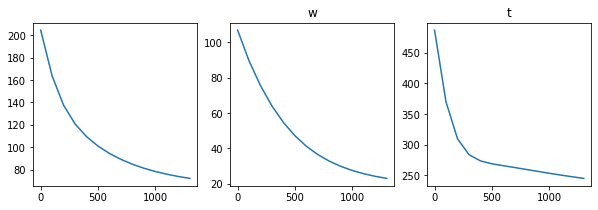

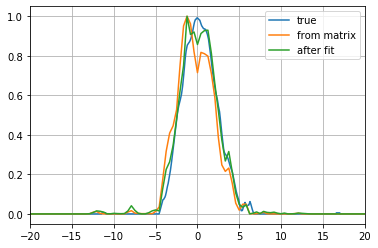

(-3.9e-15, 3.9e-15)

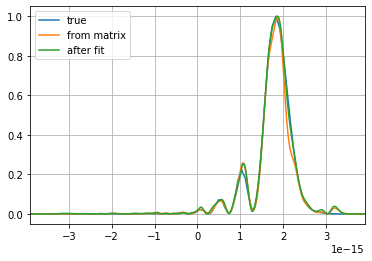

In [175]:
fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (10,3))
axs[0].plot(eps,costs)
axs[1].plot(eps,costW)
axs[2].plot(eps,costT)
axs[1].set_title('w')
axs[2].set_title('t')
plt.show()
# plt.plot(eps, costW)
# plt.plot(eps,costT)'
Q0 = Q[0].detach().numpy()
Q1=Q0[0:Nb]
Q1=np.reshape(Q1,[1,Nb])
Q2=np.concatenate(([0],Q0[Nb:2*Nb-1]))
Q2=np.reshape(Q2,[1,Nb])
Qnew=Q1+1j*Q2
Qnew = Qnew.T

plt.plot(xeV,p1.spec, label = 'true')
Ew = np.squeeze(np.matmul(p1.Qs.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), label = 'from matrix')
Ew = np.squeeze(np.matmul(Qnew.T,alphw))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), label = 'after fit')
plt.legend()

#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-20,20)
plt.grid()
plt.show()

plt.plot(vNaxis['t_sample'],  p1.tpreQ/np.max(p1.tpreQ), label = 'true')
Et = np.squeeze(np.matmul(p1.Qs.T,alpha_t))
plt.plot(vNaxis['t_sample'], Et*Et.conj()/np.max(np.abs(Et)**2),  label = 'from matrix')
Et = np.squeeze(np.matmul(Qnew.T,alpha_t))
plt.plot(vNaxis['t_sample'], Et*Et.conj()/np.max(np.abs(Et)**2),  label = 'after fit')
plt.grid()
plt.legend()
plt.xlim(-3.9e-15,3.9e-15)

(-20.0, 20.0)

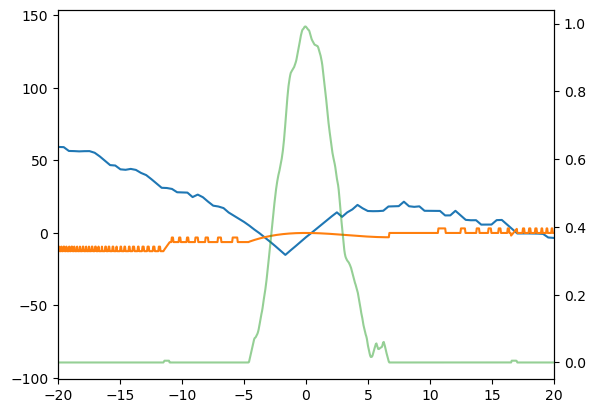

In [473]:
wr = 1200
eVshift_idx = 0
Et = np.squeeze(np.matmul(p1.Qs.T,alpha_t))
f = interp1d(vNaxis['t_sample'],Et, fill_value = 0, bounds_error = False)
Et_l = f(np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], len(vNaxis['t_sample'])))
aghh = np.argmax(np.abs(Et_l))
Ew = np.fft.ifftshift(np.fft.ifft(np.roll(Et_l,-aghh))) #need this to get imag part, must be evenly spaced
Ew = np.squeeze(np.matmul(p1.Qs.T,alphw))
#Ew = np.squeeze(np.matmul(Qguess.T,alphw))
wphase = np.unwrap(np.angle(Ew))
wphase = wphase - np.mean(wphase[int(len(wphase)/2)-10:int(len(wphase)/2)+10])
plt.plot(eV[wr-eVshift_idx:-wr-eVshift_idx], wphase[wr-eVshift_idx:-wr-eVshift_idx])
um = wphase
ew = p1.Ewin
wphase = np.unwrap(np.angle(ew))
wphase = wphase - np.mean(wphase[int(len(wphase)/2)-10:int(len(wphase)/2)+10])
plt.plot(xeV, wphase)
#plt.ylim(-20,20)
plt.twinx()
plt.plot(xeV,ew*ew.conj(), alpha = 0.5, color = 'tab:green')
plt.xlim(-20,20)

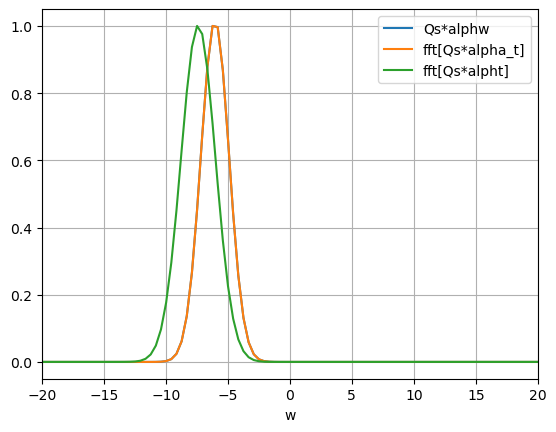

In [499]:
qs = np.zeros((36,1), dtype = complex)
qs[4]=1
Ew = np.squeeze(np.matmul(qs.T,alphw))
plt.plot(eV, Ew*Ew.conj()/np.max(Ew*Ew.conj()),label = 'Qs*alphw')
plt.xlim(-20,20)

alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) 
Et = np.squeeze(np.matmul(qs.T,alpha_t))
f = interp1d(vNaxis['t_sample'],Et, fill_value = 0, bounds_error = False)
Et_l = f(np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], len(vNaxis['t_sample'])))
aghh = np.argmax(np.abs(Et_l))
Ew = np.fft.ifftshift(np.fft.ifft(np.roll(Et_l,-aghh)))
plt.plot(eV, Ew*Ew.conj()/np.max(Ew*Ew.conj()), label = 'fft[Qs*alpha_t]')

Et = np.squeeze(np.matmul(qs.T,alpht))
f = interp1d(vNaxis['t_sample'],Et, fill_value = 0, bounds_error = False)
Et_l = f(np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], len(vNaxis['t_sample'])))
aghh = np.argmax(np.abs(Et_l))
Ew = np.fft.ifftshift(np.fft.ifft(np.roll(Et_l,-aghh)))
plt.plot(eV, Ew*Ew.conj()/np.max(Ew*Ew.conj()), label = 'fft[Qs*alpht]')
plt.xlabel('w')
plt.legend()
plt.grid()

/reg/g/psdm/sw/conda/inst/miniconda2-prod-rhel7/envs/deeplearning3/lib/python3.7/site-packages/ipykernel/__main__.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


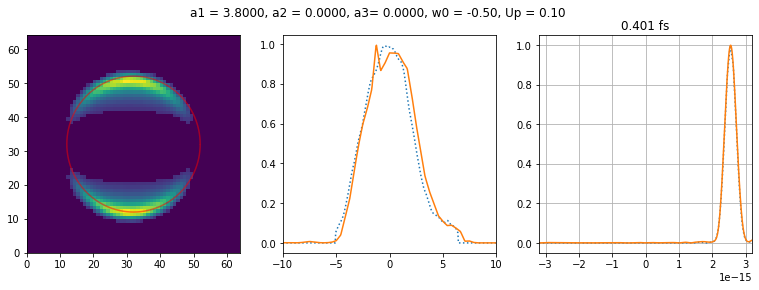

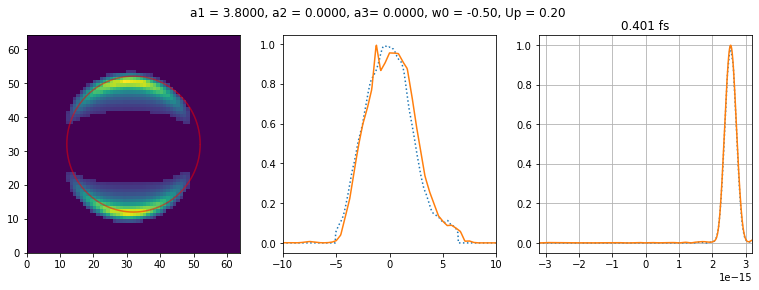

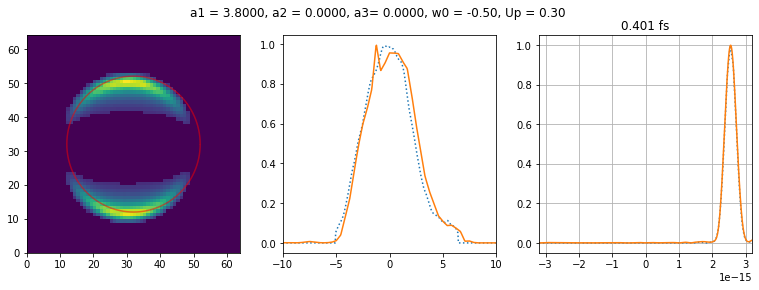

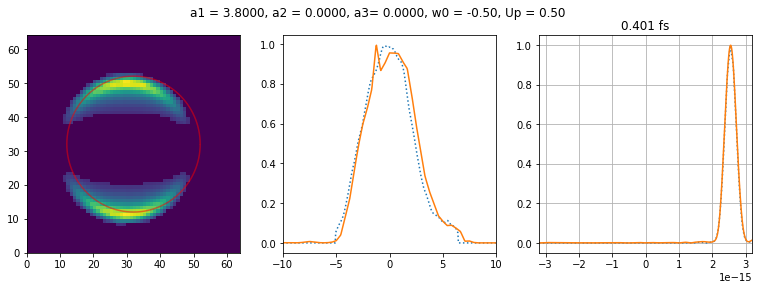

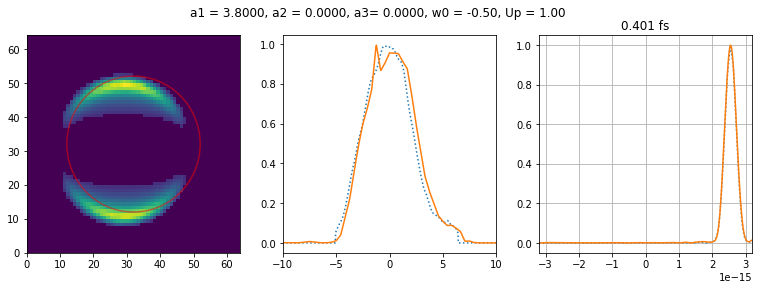

...

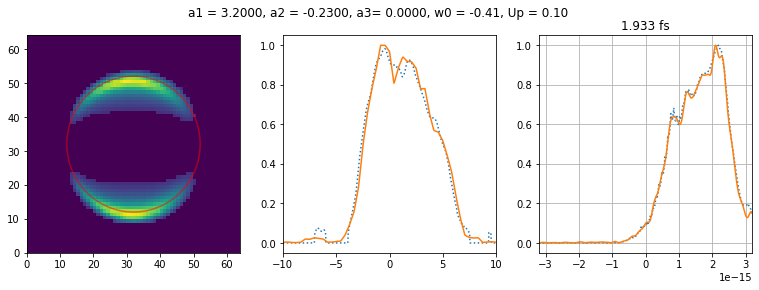

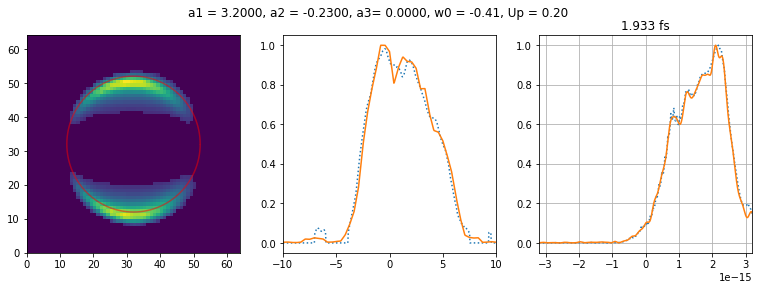

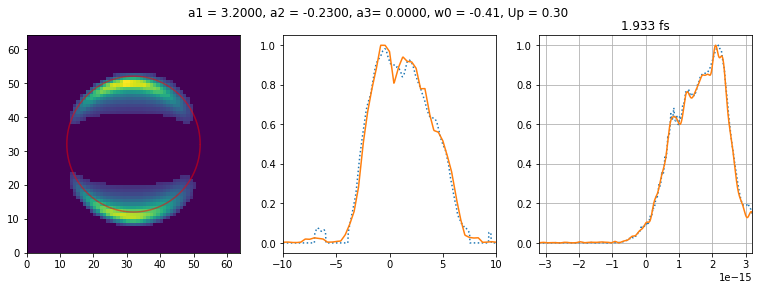

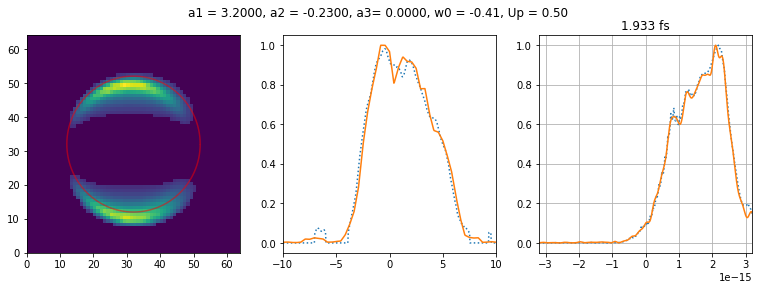

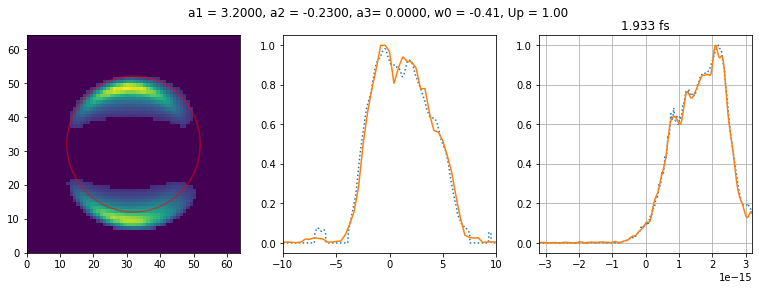

In [193]:
#31 Aug 2023
#a1s = [1.79, 1.89, 2, 2.47, 1.67, 2.68, 2.6, 2.38, 2.22, 2.13, 2.36, 2.8, 2.78, 2.33]
# a2s = [-0.154, -0.0849, 0.077, 0.07, -0.11, -0.047, -0.053, -0.037, -0.004, 0.069, 0.13, 0.18, 0.19, -0.16]
# a3s = [0, 0.005, 0.008, -0.02, -0.026, -0.03, -0.003, -0.001, -0.023, 0.022, 0.014, 0.005, -0.001, 0]

ees = [-0.5,-0.8,-0.6,-0.4,-1.2,-0.45, -2, -0.5,-1.5, -0.7, -0.47, -0.54, -0.62, -0.39, -0.48,-0.52, -1, -1.94, -2, -.41]
a1s = [3.8, 3.85, 3.5,3.75,3.9,3, 2.5, 2.77, 2, 1.8, 3.3, 3.55, 2.4, 2.93, 3.75, 2.43, 3.6, 3.8, 2.9,3.2]
a2s = [0,0,-0.001,-0.1,-0.05,0.1, 0.19, -0.1, -0.1, 0, 0.005, -0.007, -0.08, 0.069, -0.002, 0.004, -0.0077, 0.01, 0.002, -0.23]
a3s = [0,0,0.024,-0.002,-0.02,-0.04, 0.005, -0.05, 0.05, 0.001, 0, -0.001, 0,0.022, 0, -0.001, -0.003, 0, 0.001, 0]
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
xeV = pix_2_eV(np.arange(len(sss[0])), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], N)
phis = np.arange(0,360)*np.pi/180

specs = []
specs_smooth  = []
ms = []
trueQs = []
trueUps = []

nn = 0

#for a in np.arange(14,len(a1s)): 
for a in range(len(a1s)):
    a1 = a1s[a]
    a2 = a2s[a]
    a3 = a3s[a]
    w0 = ees[a]
    #s = np.mean(sss[cut],axis = 0)
    s = sss[cut][nn]
    s = s/np.max(s)
    s = fastsmooth1(s,10)
    s[s<0.05] = 0
    #s = np.roll(s,21)
    s = np.roll(s,512-np.argmax(s))

    for u in range(len(Ups)):
        Bp_basis = Bps[u]
        alphw = alphaws[u]
        alpha = alphas[u]

        p1 = Point(s, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
        p1.make_Qs()
        #Q = p1.Qs
        
        #refine Qs
        spec = p1.spec
        fftinput = np.real(p1.tpreQ/np.max(p1.tpreQ))
        fftinput = Variable(Tensor(fftinput))
        t=Variable(Tensor(vNaxis['t']))
        ts=Variable(Tensor(vNaxis['t_sample']))
        #ts=torch.linspace(t[0][0],t[0][-1],int(1e3))
        w=Variable(Tensor(vNaxis['w']))
        alphat_r=Variable(Tensor(np.real(alpha['t_sample'])))#real part
        alphat_i=Variable(Tensor(np.imag(alpha['t_sample'])))#imaginary part
        alphaw_r=Variable(Tensor(np.real(alphw)))#real part
        alphaw_i=Variable(Tensor(np.imag(alphw)))#imaginary part
        N = 2801
        xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2
        #xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])) #using tsample range
        eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
        #Interpolate spec outside of the loop to match eV
        xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
        f = interp1d(xeV,spec, bounds_error=False, fill_value = 0)
        #spec_in = f(eV[1340:-1340])
        spec_in = f(eV[1200:-1200])

        spec_in= Variable(Tensor(spec_in))
        spec_in=spec_in/torch.max(spec_in)


        q = (np.vstack((np.real(p1.Qs),np.imag(p1.Qs)[1:]))-np.imag(p1.Qs)[0]).T
        q[:,3] = 1
        Q = Tensor(q)
        Q.requires_grad = True

        n_epochs=1400
        lr=0.5e-1
        optimizer=torch.optim.Adam([Q],lr=lr)
        costs = []
        costW = []
        costT = []
        eps = []
        for epoch in range(int(n_epochs)):

            ll=loss_tot_sim(fftinput, Q, alphat_r, alphat_i, spec_in,  alphaw_r, alphaw_i, Nb)
            loss_tot_sim(fftinput, Q, alphat_r, alphat_i, spec_in,  alphaw_r, alphaw_i, Nb).backward()
            optimizer.step()
            optimizer.zero_grad()
        
        Q0 = Q[0].detach().numpy()
        Q1=Q0[0:Nb]
        Q1=np.reshape(Q1,[1,Nb])
        Q2=np.concatenate(([0],Q0[Nb:2*Nb-1]))
        Q2=np.reshape(Q2,[1,Nb])
        Qnew=Q1+1j*Q2
        Qnew = Qnew.T
        Q = Qnew
        
        
        alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample']))
        fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (13,4))
        Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
        Msol1 = np.reshape(Msol1,[64,64])
        Msol1 = Msol1*250/np.max(Msol1)
        Msol1[Msol1<32] = 0 
        axs[0].pcolormesh(Msol1)
        axs[0].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'r-', alpha = 0.5)
        axs[1].plot(xeV+w0, p1.spec, ':')
        Ew = np.squeeze(np.matmul(Q.T,alphw))
        EwEw = Ew*Ew.conj()/np.max(np.abs(Ew)**2)
        f = interp1d(eV, EwEw, fill_value = 0, bounds_error = False)
        EwEw = f(xeV)
        axs[1].plot(xeV, EwEw)
        Et = np.squeeze(np.matmul(Q.T,alpha_t))
        EtEt =  Et*Et.conj()/np.max(np.abs(Et)**2)
        axs[2].plot(vNaxis['t_sample'], p1.tpreQ/np.max(p1.tpreQ), ':')
        axs[2].plot(ts,EtEt)
        duration = FWHM(ts*1e15,np.roll(EtEt, int(len(EtEt)/2)-np.argmax(EtEt)))
        axs[2].set_title('%1.3f fs' %duration)
        axs[1].set_xlim(-10,10)
        axs[2].set_xlim(-3.2e-15,3.2e-15)
        axs[2].grid()
        plt.suptitle('a1 = %1.4f, a2 = %1.4f, a3= %1.4f, w0 = %1.2f, Up = %1.2f' %(a1,a2,a3,w0,Ups[u]))
        plt.show()
        specs.append(np.real(EwEw))
        specs_smooth.append(p1.spec)
        ms.append(Msol1)
        trueQs.append(Q)
        trueUps.append(Ups[u])
    nn += 1
    if nn>= len(sss[cut]): nn = 0

In [195]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Aug31_0.npy', specs)
#np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_sm_Jul12_0.npy', specs_smooth)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Aug31_0.npy', ms)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Qs_Aug31_0.npy', trueQs)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ups_Aug31_0.npy', trueUps)

In [ ]:
## specifics as targeting certain pulse durations
a1s = [1.79, 1.89, 2, 2.47, 1.67, 2.68, 2.6, 2.38, 2.22, 2.13, 2.36, 2.8, 2.78, 2.33]
a2s = [-0.154, -0.0849, 0.077, 0.07, -0.11, -0.047, -0.053, -0.037, -0.004, 0.069, 0.13, 0.18, 0.19, -0.16]
a3s = [0, 0.005, 0.008, -0.02, -0.026, -0.03, -0.003, -0.001, -0.023, 0.022, 0.014, 0.005, -0.001, 0]
ees = [0, 1, -1, 1, 0.5, 0.3, 0.8, -0.4, 1, 0.6, 0.2, 1.2, 1, 0.9]
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
xeV = pix_2_eV(np.arange(len(sss[0])), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], N)
phis = np.arange(0,360)*np.pi/180

specs = []
specs_smooth  = []
ms = []
trueQs = []
trueUps = []


for a in range(len(a1s)):
    a1 = a1s[a]
    a2 = a2s[a]
    a3 = a3s[a]
    w0 = ees[a]

    #s = sss[cut][n]
    s = np.mean(sss[cut],axis = 0)
    s = s/np.max(s)
    s[s<0] = 0
    #s = np.roll(s,21)
    s = np.roll(s,512-np.argmax(s))

    for u in range(len(Ups)):
        Bp_basis = Bps[u]
        alphw = alphaws[u]
        alpht = alphats[u]

        p1 = Point(s, pixpereV = 22, w0 = w0, a1 = a1, a2 = a2, a3 = a3)
        p1.make_Qs()
        Q = p1.Qs
        fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (13,4))
        Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
        Msol1 = np.reshape(Msol1,[64,64])
        Msol1 = Msol1*250/np.max(Msol1)
        Msol1[Msol1<32] = 0 
        axs[0].pcolormesh(Msol1)
        axs[0].plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'r-', alpha = 0.5)
        axs[1].plot(xeV+w0, p1.spec, ':')
        Ew = np.squeeze(np.matmul(Q.T,alphw))
        EwEw = Ew*Ew.conj()/np.max(np.abs(Ew)**2)
        f = interpolate.interp1d(eV, EwEw, fill_value = 0, bounds_error = False)
        EwEw = f(xeV)
        axs[1].plot(xeV, EwEw)
        Et = np.squeeze(np.matmul(Q.T,alpht))
        axs[2].plot(vNaxis['t_sample'], p1.tpreQ/np.max(p1.tpreQ), ':')
        axs[2].plot(ts, Et*Et.conj()/np.max(np.abs(Et)**2))
        duration = FWHM(ts[t1:t2]*1e15,np.roll(EtEt[t1:t2], int(len(EtEt[t1:t2])/2)-roll_to))
        axs[2].set_title('%1.3f fs' %duration)
        axs[1].set_xlim(-10,10)
        axs[2].set_xlim(-3.2e-15,3.2e-15)
        axs[2].grid()
        plt.suptitle('a1 = %1.4f, a2 = %1.4f, a3= %1.4f, w0 = %1.2f, Up = %1.2f' %(a1,a2,a3,w0,Ups[u]))
        specs.append(np.real(EwEw))
        specs_smooth.append(p1.spec)
        ms.append(Msol1)
        trueQs.append(Q)
        trueUps.append(Ups[u])

In [ ]:
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jul12_0.npy', specs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_sm_Jul12_0.npy', specs_smooth)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jul12_0.npy', ms)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Qs_Jul12_0.npy', trueQs)
# np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ups_Jul12_0.npy', trueUps)

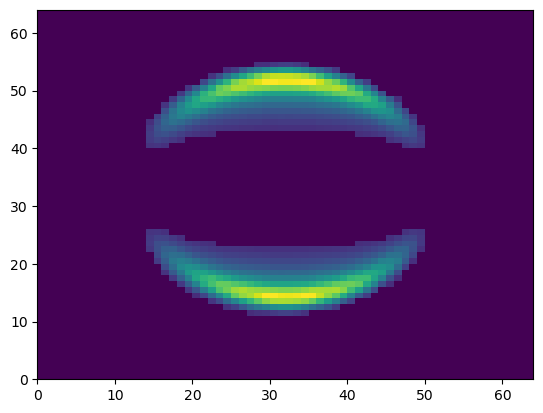

In [228]:
plt.pcolormesh(ms[0])

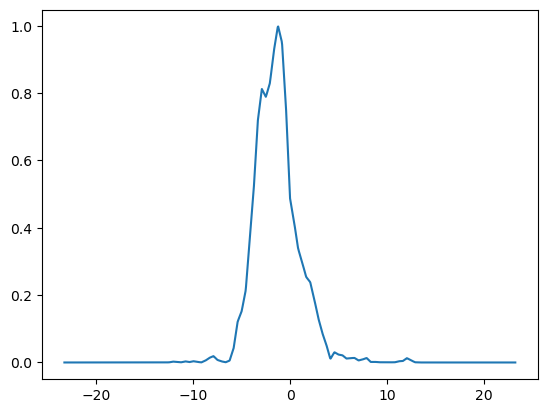

In [60]:
plt.plot(xeV,specs[0])

/tmp/ipykernel_23517/3882658165.py:58: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  self.Qs = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]


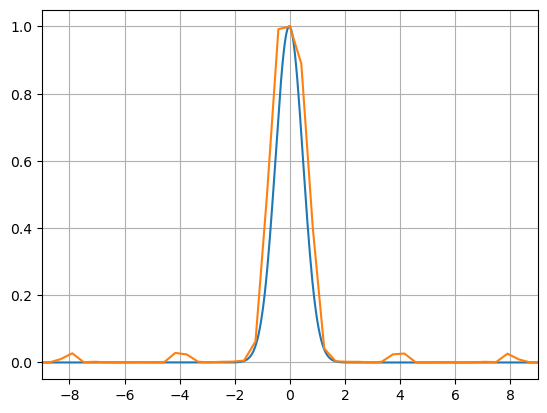

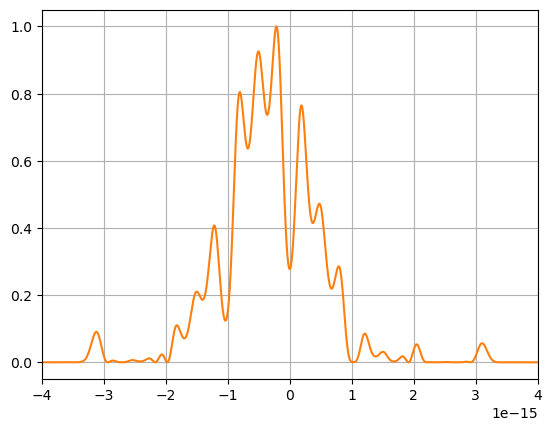

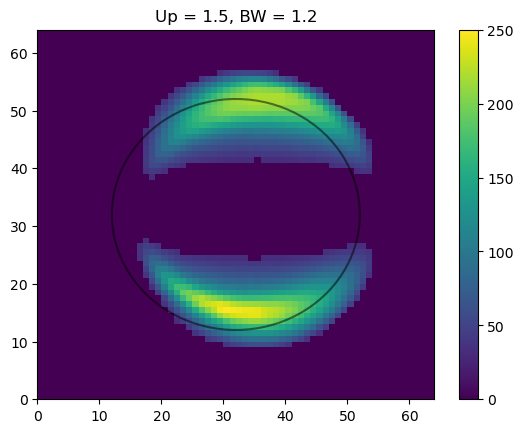

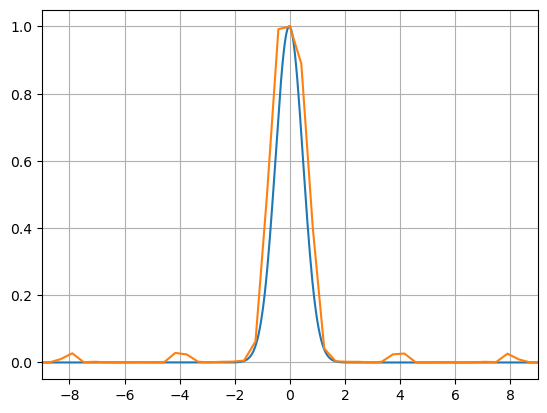

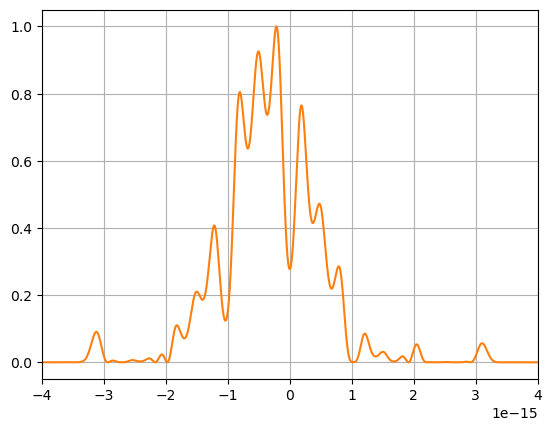

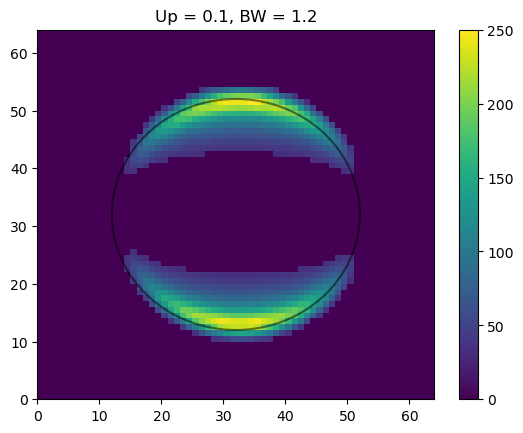

In [61]:
u = -1
x = np.linspace(-23.3,23.3,1024)
sig = .5
sss = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(x-0)**2/sig**2))
sss = sss/np.max(sss)
p1 = Point(sss, pixpereV = 22, w0 = 0, a1 = -.1, a2 = 0.0003, a3 = 0.000)
p1.make_Qs()
xeV = pix_2_eV(np.arange(len(sss)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
plt.plot(xeV+w0, p1.spec)
Ew = np.squeeze(np.matmul(p1.Qs.T,alphaws[u]))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-9,9)
plt.grid()
plt.show()
Et = np.squeeze(np.matmul(p1.Qs.T,alphas[u]['t_sample']))
plt.plot(vNaxis['t_sample'],Et*Et.conj()/np.max(np.abs(Et)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-4e-15,4e-15)
plt.grid()
plt.show()

Q = p1.Qs
Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bps[u]))
Msol1 = np.reshape(Msol1, [64,64])
Msol1 = Msol1/np.max(Msol1)*250
Msol1[Msol1<32] = 0
ms.append(Msol1)
specs.append(ss)
plt.pcolormesh(Msol1)
plt.title('Up = %1.1f, BW = %1.1f' %(Ups[u],2.355*sig))
phi_rad = np.arange(0,360)*np.pi/180
plt.plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
plt.colorbar()
plt.show()

u = 0
x = np.linspace(-23.3,23.3,1024)
sig = .5
sss = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(x-0)**2/sig**2))
sss = sss/np.max(sss)
p1 = Point(sss, pixpereV = 22, w0 = 0, a1 = -.1, a2 = 0.0003, a3 = 0.000)
p1.make_Qs()
xeV = pix_2_eV(np.arange(len(sss)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(vNaxis['t_sample'][0])/2 #((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
plt.plot(xeV+w0, p1.spec)
Ew = np.squeeze(np.matmul(p1.Qs.T,alphaws[u]))
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-9,9)
plt.grid()
plt.show()
Et = np.squeeze(np.matmul(p1.Qs.T,alphas[u]['t_sample']))
plt.plot(vNaxis['t_sample'],Et*Et.conj()/np.max(np.abs(Et)**2), 'tab:orange')
#plt.plot(eV,Ew/np.max(np.abs(Ew)), 'tab:orange')
plt.xlim(-4e-15,4e-15)
plt.grid()
plt.show()

Q = p1.Qs
Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bps[u]))
Msol1 = np.reshape(Msol1, [64,64])
Msol1 = Msol1/np.max(Msol1)*250
Msol1[Msol1<32] = 0
ms.append(Msol1)
specs.append(ss)
plt.pcolormesh(Msol1)
plt.title('Up = %1.1f, BW = %1.1f' %(Ups[u],2.355*sig))
phi_rad = np.arange(0,360)*np.pi/180
plt.plot(32+ 20*np.cos(phis), 32+ 20*np.sin(phis), 'k-', alpha = 0.5)
plt.colorbar()


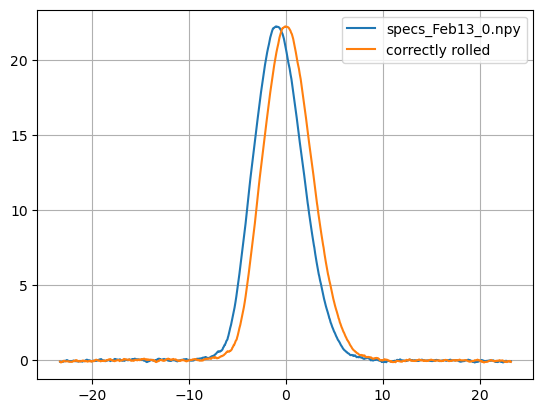

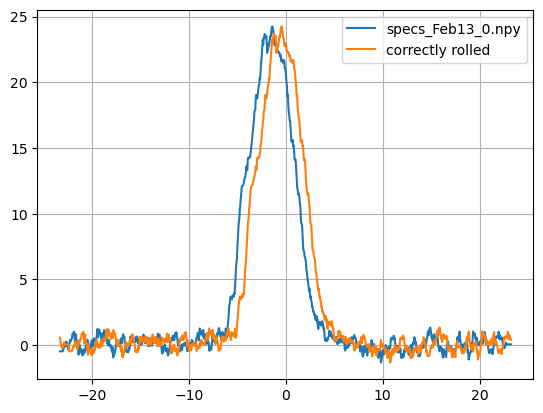

In [16]:
sss = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Feb3_110.npy')
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
plt.plot(xeV,np.mean(sss,axis=0), label  = 'specs_Feb13_0.npy')
plt.plot(xeV,np.roll(np.mean(sss,axis=0),+21), label = 'correctly rolled')
plt.legend()
plt.grid()
plt.show()
n=30
plt.plot(xeV,sss[n], label  = 'specs_Feb13_0.npy')
plt.plot(xeV,np.roll(sss[n],+21), label = 'correctly rolled')
plt.legend()
plt.grid()

In [287]:
w0 = -5

a1 = 0.1
a2 = 0
a3 = 0.00004

spec = sss
spec[spec<0] = 0
Ew0 = np.sqrt(spec)

       
xeV = pix_2_eV(np.arange(1024), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
xeV = xeV + w0

n1 = 254 # spans range of vNaxis['w'] and centered around zero, in this case pix 512
n2 = -n1+1 
xeV = xeV[n1:n2] 
Ew0 = Ew0[n1:n2] 


f = interpolate.interp1d(xeV, Ew0, fill_value = 'extrapolate')
NN = 512*2 #how many points you want to use for the FFT, power of 2
N = len(xeV)
fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
xxeV = fx(np.linspace(0, N-1, NN))
Ew0 = f(xxeV)

Ew_in = Ew0*np.exp(1j*(a1*(np.pi*2*(xxeV-w0))+a2*(np.pi*2*(xxeV-w0))**2+a3*(np.pi*2*(xxeV-w0))**3)) #add in the phase
b = np.exp(1j*(a1*(np.pi*2*(xxeV-w0))+a2*(np.pi*2*(xxeV-w0))**2+a3*(np.pi*2*(xxeV-w0))**3)) #add in the phase

/tmp/ipykernel_2694/288023328.py:41: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]


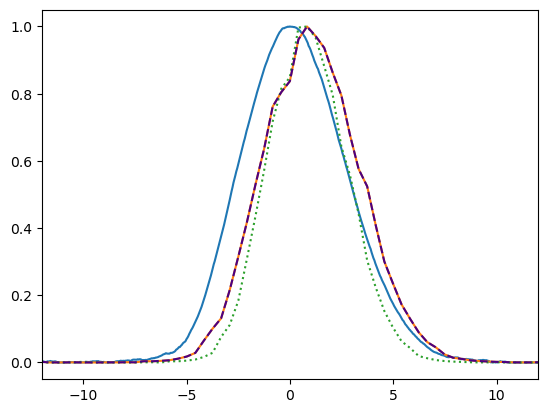

In [218]:
w0 = 1
a1 = 0.1#0.1
a2 = 0#0.001
a3 = 0#-0.0001
xeV = pix_2_eV(np.arange(len(sss)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = 512)
N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 

# Q1 = np.zeros((36,1), dtype = complex) 
# Q1[10] = 1
# Q1[1] = -.001j
Q1 = make_Qs(sss, 22, w0, a1, a2, a3, vNaxis, alpha)

Et = np.squeeze(np.matmul(Q1.T,alpha['t_sample']))
Ew = np.squeeze(np.matmul(Q1.T,alphw))

plt.plot(xeV,sss)
plt.plot(eV,Ew*Ew.conj()/np.max(np.abs(Ew)**2), 'tab:orange')
plt.xlim(-12,12)


st = np.fft.ifftshift(np.fft.ifft(Et))
specc = st*np.conj(st)
specc = specc/np.max(np.abs(specc))
plt.plot(eV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), ':', color = 'tab:green')


f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 0, bounds_error = False)
N = 2801
ts = np.linspace(vNaxis['t_sample'][0],-vNaxis['t_sample'][0], N)
st = np.fft.ifftshift(np.fft.ifft(f(ts)))
specc = st*np.conj(st)
specc = specc/np.max(np.abs(specc))

xf = np.arange(-N/2-1/2,N/2-1/2,1)/np.abs(ts[0])/2 #(ts[-1] - ts[0])  #Hz???
xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9
plt.plot(xxeV,specc, '--', color = 'indigo')

# f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate')
# N = 2801
# ts = np.linspace(vNaxis['t_sample'][0],vNaxis['t_sample'][-1], N)
# st = np.fft.ifftshift(np.fft.ifft(f(ts)))
# specc = st*np.conj(st)
# specc = specc/np.max(np.abs(specc))

# xf = np.arange(-N/2+1/2,N/2+1/2,1)/(ts[-1] - ts[0])  #Hz???
# xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9
# plt.plot(xxeV,specc, 'pink')

Text(0.5, 1.0, "Diff vNaxis['t_sample']")

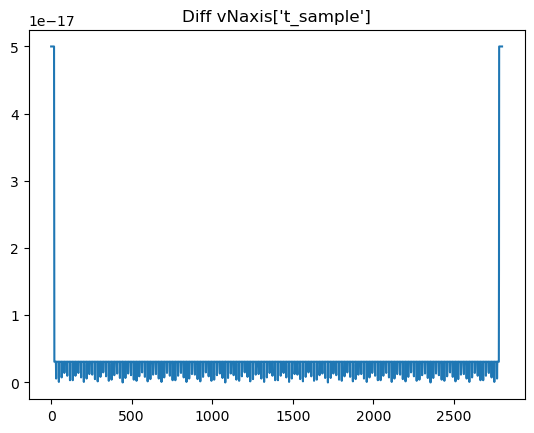

In [159]:
plt.plot(np.diff(vNaxis['t_sample']))#[:100]
plt.title("Diff vNaxis['t_sample']")

Text(0.5, 1.0, "Diff vNaxis['t']")

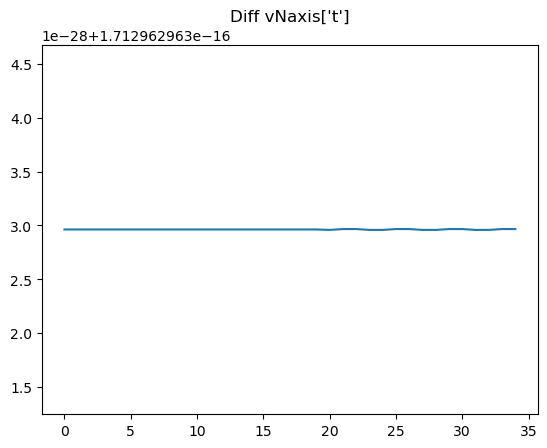

In [160]:
plt.plot(np.diff(vNaxis['t']))
plt.title("Diff vNaxis['t']")

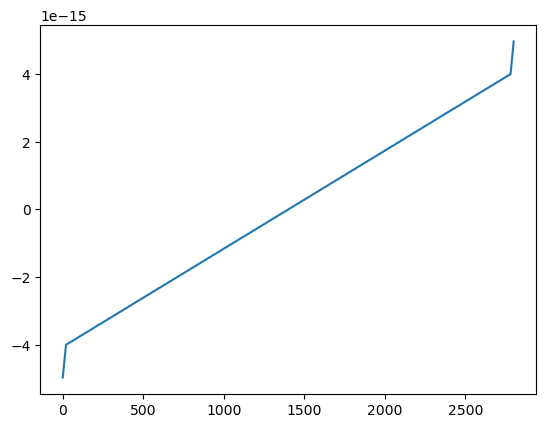

In [150]:
plt.plot(np.arange(len(vNaxis['t_sample'])),vNaxis['t_sample'])

-15.727272727272728 7.727272727272728
-14.393939393939394 9.060606060606062
-13.060606060606062 10.393939393939394


/tmp/ipykernel_2694/2581985577.py:68: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Q1 = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]


-11.727272727272728 11.727272727272728
-10.393939393939394 13.060606060606062
-9.060606060606062 14.393939393939394
-7.727272727272728 15.727272727272728


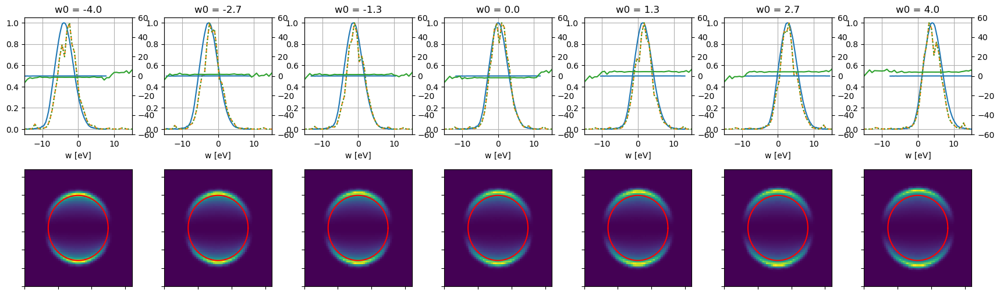

In [192]:
#check stuff
n = 7
ees = np.linspace(-4,4,n)
a1 = 0.008 #0.5 #-0.5
a2 = 0# -0.0001 #-0.01 #-0.002#0.001
a3 = 0 #0.0001 #-0.00001 #0.0001

N = 2801
xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 

fig,axs = plt.subplots(nrows = 2, ncols = n, figsize =(n*3, 2*3))
plt.subplots_adjust(hspace = 0.3, wspace = 0.3)

for i in range(n):
    ee = ees[i]
    spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
    pp =0 #1200
    spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
    
    N = len(spec)
    xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
    xeV = xeV + ee

    n1 = 254 #40
    n2 = -n1+1 #400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                    #also need it to be centered around where you are calling zero or there will be an offset
    t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
    t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
    xeV = xeV[n1:n2] 
    spec = spec[n1:n2] 
    #spec = np.fft.fftshift(spec)

    axs[0][i].plot(xeV, np.real((spec)**2/np.max(spec**2)), label = 'vls, Ew')

    f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
    NN = 512*2
    NNN = 0
    N = len(spec)
    fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
    xeV = fx(np.linspace(0-NNN, N-1+NNN, NN))
    print(xeV[0],xeV[-1])
    spec = f(xeV)
    spec2 = f(eV)
    xf = 2.9979E8*xeV/1239.84e-9
    
    spec = (spec)*np.exp(1j*(a1*(np.pi*2*(xeV-ee))+a2*(np.pi*2*(xeV-ee))**2+a3*(np.pi*2*(xeV-ee))**3))
    spec2 = (spec2)*np.exp(1j*(a1*(np.pi*2*(eV-ee))+a2*(np.pi*2*(eV-ee))**2+a3*(np.pi*2*(eV-ee))**3))
    wphase = np.unwrap(np.angle(spec))
    wphase = wphase - np.mean(wphase)
    ax = axs[0][i].twinx()
    ax.plot(xeV,wphase*0.15, color = 'tab:blue')
    
    f = xf[-1] - xf[0]
    spec = np.fft.fftshift(spec)
    N = len(spec)
    t = np.linspace(-N/f/2+1/f/2,N/f/2+1/f/2, N) 
    FFT = np.fft.fftshift(np.fft.fft(spec))


    car3 = np.exp(-1.j*(ee)/hbar*t)
    FFT = FFT*car3 #add in the frequency due to offset from zero frequency
    f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
    x = f(vNaxis['t_sample'])
    alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

    Q = np.reshape(np.matmul(x, np.linalg.pinv(alpha_t)), [36,1])
    Q1 = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]
    Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))


    Et = np.squeeze(np.matmul(Q.T,alpha_t))
    f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    xf = np.arange(-N/2+1/2,N/2+1/2,1)/(ts[-1] - ts[0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), '--', label = 'Ew -> Et -> Q -> Et -> Ew')
    
    Et = np.squeeze(np.matmul(Q1.T,alpha_t))
    f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    xf = np.arange(-N/2+1/2,N/2+1/2,1)/(ts[-1] - ts[0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), ':', label = 'Ew -> Et -> Q -> Et -> Ew')
    aghh = np.argmax(np.abs(f(ts)))
    #aghh = 0 
    Ew = np.fft.ifftshift(np.fft.ifft(np.roll(f(ts),-aghh)))
    wphase = np.unwrap(np.angle(Ew))
    wphase = wphase - np.mean(wphase)
    ax.plot(xxeV,wphase, color = 'tab:green')
    
    

    axs[0][i].set_xlim(-15,15)
    axs[0][i].set_title('w0 = %1.1f' %ee)
    axs[0][i].grid()
    axs[0][i].set_xlabel('w [eV]')
    axs[1][i].pcolormesh((np.reshape(Msol1, [64,64])))
    axs[1][i].set_xticklabels([])
    axs[1][i].set_yticklabels([])
    ax.set_ylim(-60,60)

    r = 285 #360
    binn = 32/2
    phi_rad = np.arange(0,360)*np.pi/180
    axs[1][i].plot((512+r*np.cos(phi_rad))/binn, (512+r*np.sin(phi_rad))/binn, c='r')

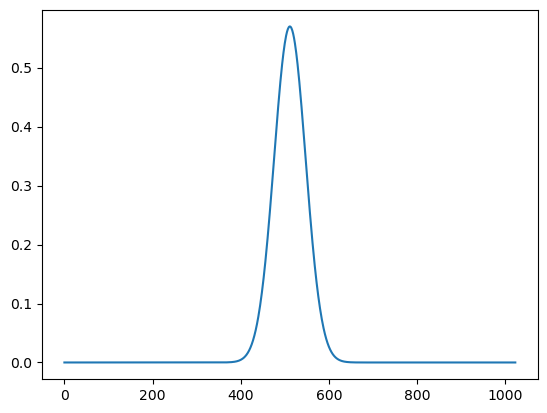

In [1187]:
x = np.linspace(-10,10,1024)
sig = 0.7
sss = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(x-0)**2/sig**2))
plt.plot(sss)

/tmp/ipykernel_8289/2718444994.py:39: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_w.conj(),np.reshape(spec2,(2801,1))*2*np.pi*(xf[1]-xf[0])))[0]


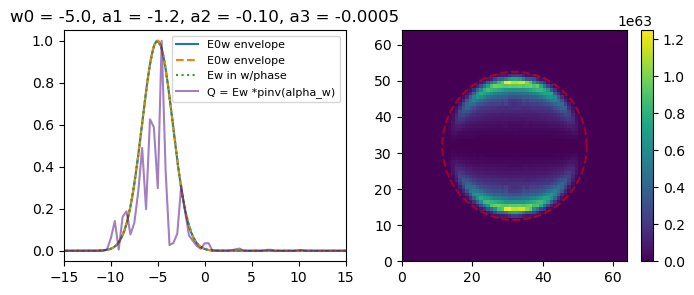

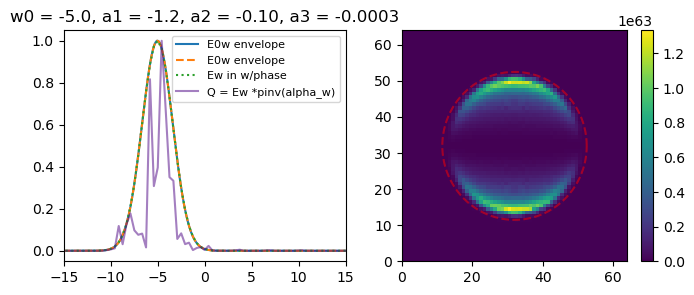

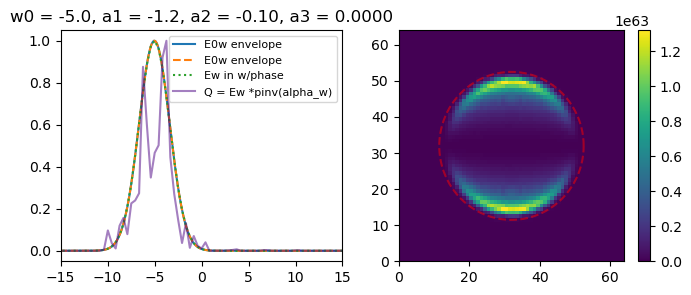

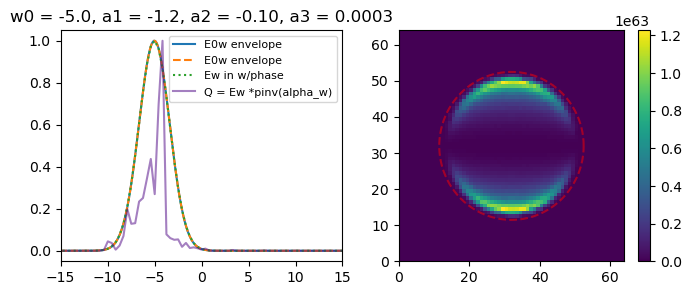

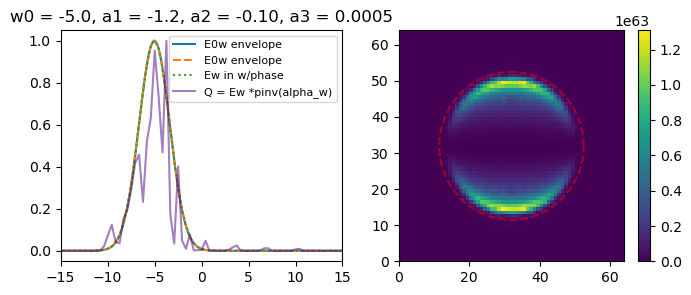

...

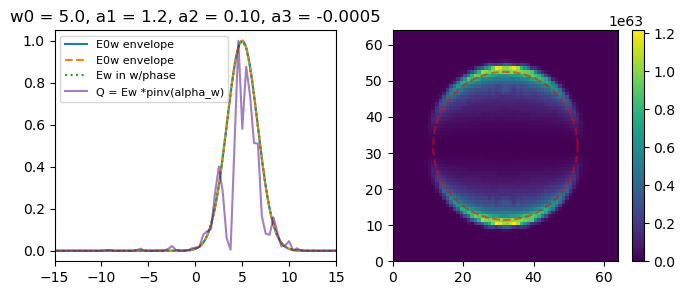

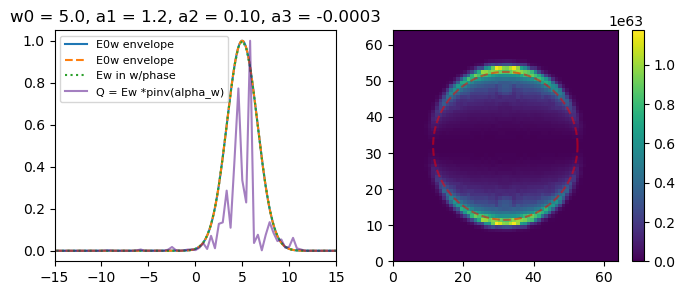

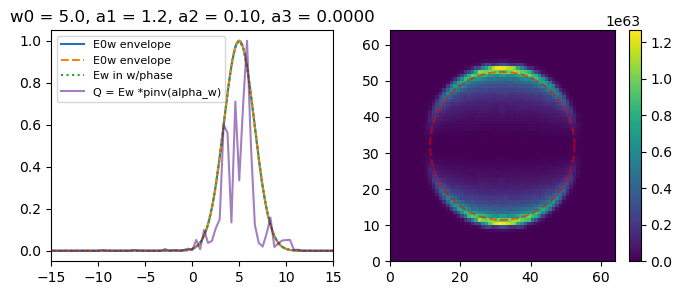

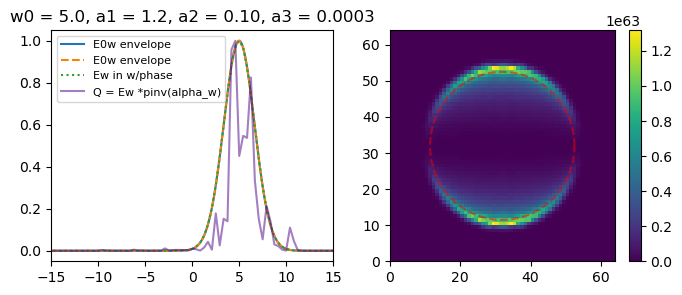

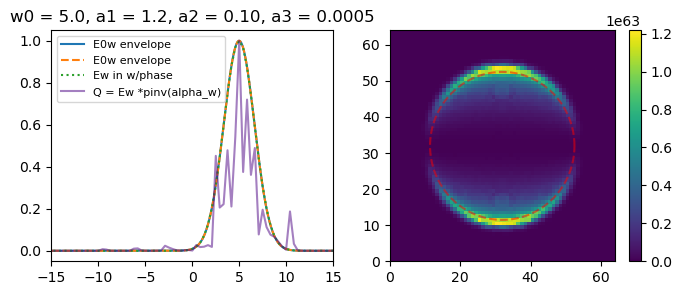

In [1200]:
ees = np.linspace(-5,5,5)
a1s = np.linspace(-1.2,1.2,5)
a2s = np.linspace(-0.1,0.1,5)
a3s = np.linspace(-0.0005,0.0005,5)
phis = np.linspace(0,360,100)*np.pi/180

for ee in ees:
    for a1 in a1s:
        for a2 in a2s:
            for a3 in a3s:
                fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (8,3))

                spec = np.sqrt(sss) #Ef0
                pp =1200
                spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
                N = len(spec)
                xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
                xeV = xeV + ee
                axs[0].plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), label = 'E0w envelope')


                f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
                NN = 1024
                fx = interpolate.interp1d(np.arange(len(xeV)), xeV, fill_value = 'extrapolate') #make sure f is evenly spaced
                xeV = fx(np.linspace(0, len(xeV), NN))
                spec = f(xeV)
                axs[0].plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), '--', label = 'E0w envelope')

                N = 2801
                xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
                eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
                spec_at_w_sample = f(eV)
                spec2 = spec_at_w_sample*np.exp(1j*(a1*(np.pi*2*xf)+a2*(np.pi*2*xf)**2+a3*(np.pi*2*xf)**3))
                axs[0].plot(eV, spec2*spec2.conj()/np.max(spec2*spec2.conj()),':', label = 'Ew in w/phase')

                Q1 = np.reshape(np.matmul(np.reshape(spec2,(1,2801)), np.linalg.pinv(alpha_w)), [36,1])
                #Q = np.reshape(np.matmul(np.array(spec_at_w_sample,dtype = complex), np.linalg.pinv(alpha_w)), [36,1])
                #Q = np.matmul(np.linalg.pinv(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0])),np.matmul(alpha_w.conj(),np.reshape(spec_at_w_sample,(2801,1))*2*np.pi*(xf[1]-xf[0])))
                Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_w.conj(),np.reshape(spec2,(2801,1))*2*np.pi*(xf[1]-xf[0])))[0]

                Msol2=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
                Msol2 = np.reshape(Msol2,[64,64])#, [int(np.sqrt(Msol1.shape[0])),int(np.sqrt(Msol1.shape[0]))]))
                p = axs[1].pcolormesh(Msol2)
                plt.colorbar(p, ax =axs[1])
                axs[1].plot((511.5+ 328*np.cos(phis))/16, (511.5+ 328*np.sin(phis))/16, 'r--', alpha = 0.5)


                Ew = np.squeeze(np.matmul(Q.T,alpha_w))
                EwEw = np.real(Ew*Ew.conj())
                #EwEw = fastsmooth1(EwEw, 2)
                EwEw = EwEw[1340:-1341]
                EwEw = EwEw/np.max(EwEw)
                axs[0].plot(eV[1340:-1341],EwEw, label = 'Q = Ew *pinv(alpha_w)', color = 'indigo', alpha = 0.5)
                axs[0].set_xlim(-15,15)
                axs[0].legend(fontsize = 8)
                axs[0].set_title('w0 = %1.1f, a1 = %1.1f, a2 = %1.2f, a3 = %1.4f' %(ee,a1,a2,a3))
                
                plt.show()

In [7]:
Q = np.array([[ 0.03707759+0.j        ],
       [ 0.08203505+0.11701591j],
       [-0.90492237-0.64258611j],
       [-0.7348488 +0.11722899j],
       [-0.34869632+0.328987j  ],
       [-0.22415948+0.05243224j],
       [-0.1477793 +0.0150217j ],
       [-0.19492874-0.1489372j ],
       [ 0.57834554-0.30397394j],
       [ 0.34745026-0.00481135j],
       [ 0.51322579-0.07231107j],
       [ 0.37114888+0.01035086j],
       [ 0.15581702-0.15608743j],
       [ 0.88961846-0.00595623j],
       [-0.52094936+0.84299016j],
       [-0.25523382+0.10702207j],
       [-0.81323135-0.14806595j],
       [-0.34189668-0.10188241j],
       [-0.01899661+0.03700193j],
       [ 0.08255794+0.15559797j],
       [-0.68559331+0.42118999j],
       [ 1.08720124-0.20505619j],
       [ 0.08332486+0.4336223j ],
       [ 0.31919125+0.15543756j],
       [ 0.02242486+0.0415572j ],
       [-0.01589709+0.11844697j],
       [ 0.02574129+0.42892036j],
       [-0.97821063+0.28628924j],
       [ 1.50949812+1.21994221j],
       [-0.79793817-0.88265115j],
       [-0.03021959-0.07211957j],
       [-0.22272743-0.20419972j],
       [-0.38973758-1.87574291j],
       [ 3.43795013-0.17121179j],
       [ 0.39475396+0.21401574j],
       [ 0.13528456+0.14789328j]])

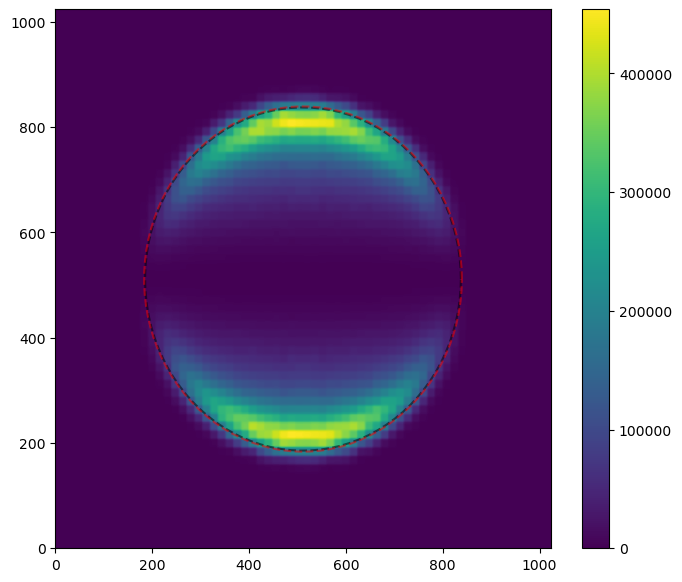

In [8]:
plt.figure(figsize = (8,7))
phis = np.linspace(0,360,100)*np.pi/180
Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))


#Msol1 =  make_bg_fixed(sss, ee, vNaxis0, alpha0, Bp_basis0, vls_pitch = 5.399977, order = 3)
Msol1 = np.reshape(Msol1,[64,64])#, [int(np.sqrt(Msol1.shape[0])),int(np.sqrt(Msol1.shape[0]))]))
ii = gf(cv2.resize(Msol1, (1024,1024), interpolation = cv2.INTER_AREA),2)
plt.pcolormesh(ii)
plt.colorbar()
plt.plot(511.5+ 326*np.cos(phis), 511.5+ 326*np.sin(phis), 'k--', alpha = 0.5)
plt.plot(511.5+ 328*np.cos(phis), 511.5+ 328*np.sin(phis), 'r--', alpha = 0.5)



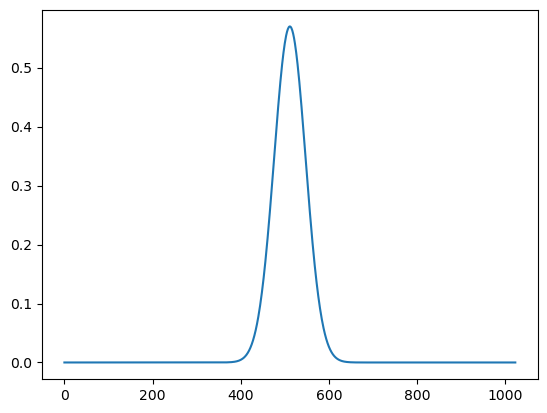

In [423]:
print(vNaxis['t'][0],vNaxis['t'][-1])
print(vNaxis['t_sample'][0],vNaxis['t_sample'][-1])
print(1239.84*vNaxis['w'][0]/2.9979E8/(2*np.pi)*1e-9,1239.84*vNaxis['w'][-1]/2.9979E8/(2*np.pi)*1e-9)

-2.997685185185185e-15 2.997685185185182e-15
-4.975e-15 4.974999999999926e-15
-11.736431718419107 11.736431718419107


In [457]:
xf = np.arange(-N/2+1/2,N/2+1/2,1)/(vNaxis['t'][-1] - vNaxis['t'][0])  #Hz???
xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9
print(xxeV[0],xxeV[-1])

-965.7406671156299 965.7406671156299


In [451]:
len(vNaxis['t_sample'])

2801

In [492]:
N = 2801
xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])) #using tsample range
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
print(eV[0],eV[-1])

-581.9068322700306 581.9068322700306


-77.81818181818183 77.77272727272728


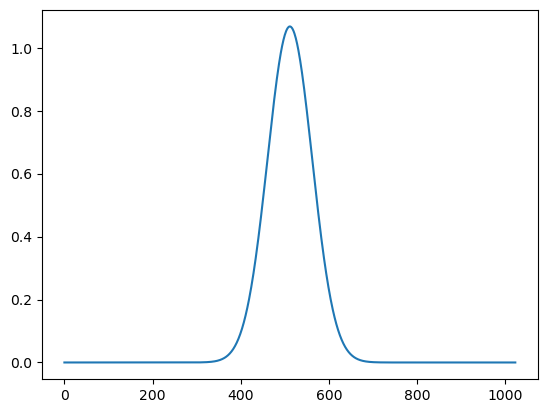

In [490]:
spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
plt.plot(spec)
pp =1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
N = len(spec)
xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
print(xeV[0],xeV[-1])

(-20.0, 20.0)

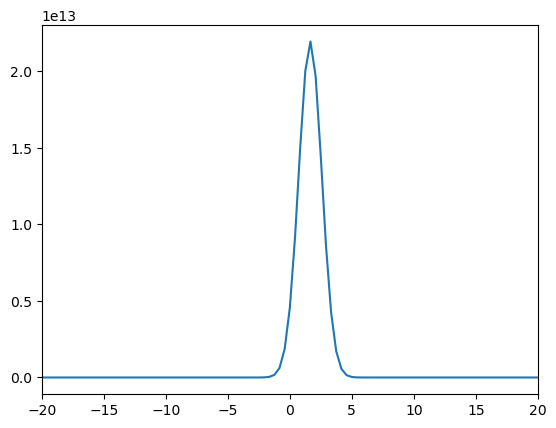

In [753]:
Q = np.zeros((36,1), dtype = complex)
Q[14] = 1
Ew=np.squeeze(np.matmul(Q.T,alphw))
plt.plot(eV, Ew*Ew.conj())
plt.xlim(-20,20)

(-20.0, 20.0)

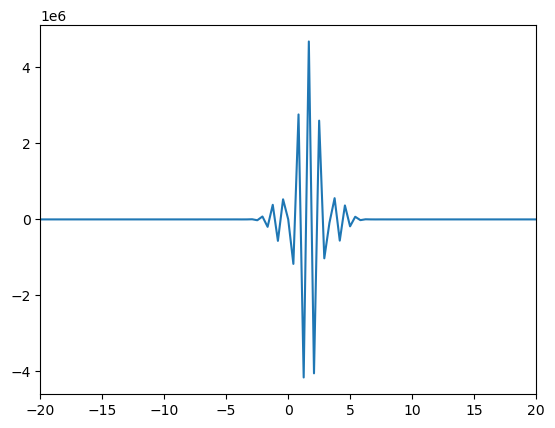

In [683]:
plt.plot(eV,np.real(Ew))
plt.xlim(-20,20)

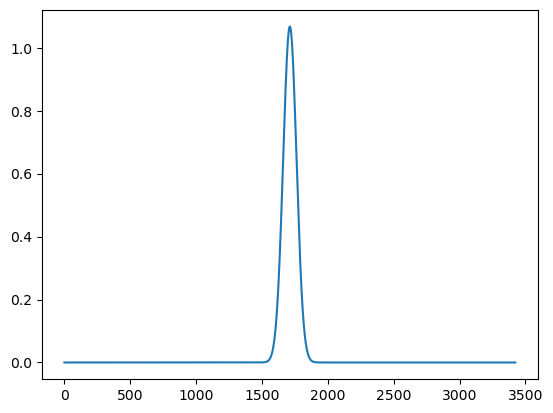

In [473]:
plt.plot(spec)

-77.81818181818183 77.77272727272728


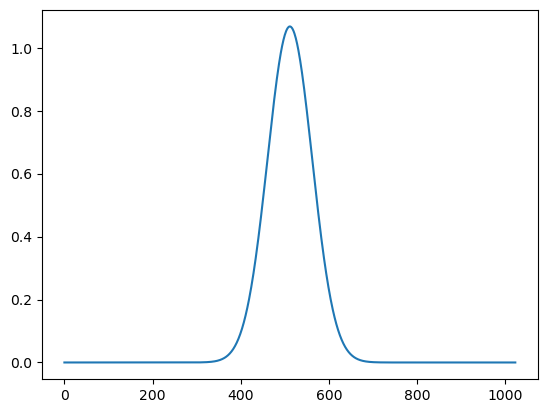

In [637]:
spec = np.sqrt(sss) #sqrt of intensity spectra to get E(w)
plt.plot(spec)
pp =1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
N = len(spec)
xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
print(xeV[0],xeV[-1])

-77.81818181818183 77.72727272727273
-77.81818181818183 77.81818181818183


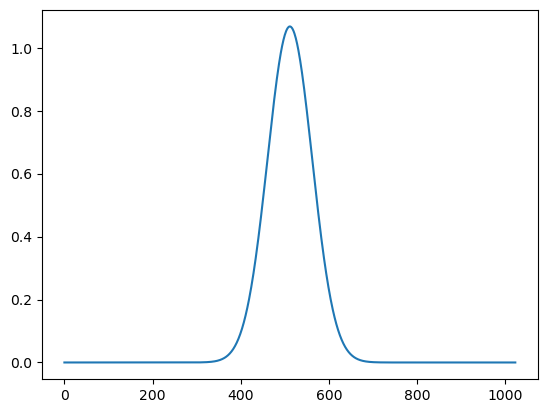

In [644]:
spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
plt.plot(spec)
pp =1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
N = len(spec)
xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)

n1 = 0 #1478#0
n2 = -1 #1950 #3400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                #also need it to be centered around where you are calling zero or there will be an offset
t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
xeV = xeV[n1:n2] 
print(xeV[0],xeV[-1])
spec = spec[n1:n2] 
spec = np.fft.fftshift(spec)

f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
NN = 512*2
N = len(spec)
fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
xeV = fx(np.linspace(0, N+1, NN))
print(xeV[0],xeV[-1])
spec = f(xeV)
xf = 2.9979E8*xeV/1239.84e-9

f = xf[-1] - xf[0]
N = len(spec)
t = np.linspace(-N/f/2,N/f/2, N) 

array([-1.50307009-0.21322043j, -1.47061064-0.21322043j,
       -1.43949643-0.21322043j, ..., -1.60945989-0.21322043j,
       -1.57239215-0.21322043j, -1.53696459-0.21322043j])

In [461]:
xf[0],xf[-1]

(-1.6398255200084472e+16, 2.09594320821455e+16)

In [460]:
t[0],t[-1]

(-1.3705345197949243e-14, 1.3705345197949243e-14)

In [749]:
sss = np.array(sss,dtype = complex)
sss

array([2.75453672e-45+0.j, 4.10352281e-45+0.j, 6.10838460e-45+0.j, ...,
       6.10838460e-45+0.j, 4.10352281e-45+0.j, 2.75453672e-45+0.j])

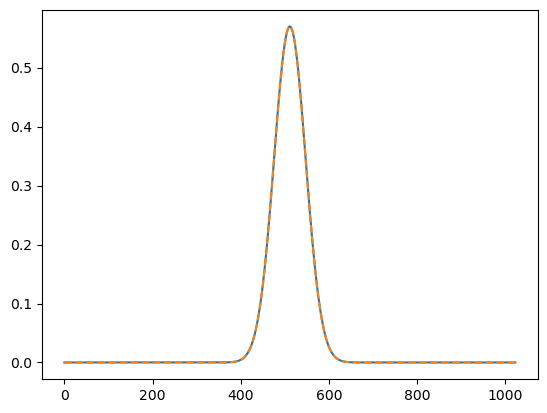

In [750]:
spec = np.sqrt(sss)#+0.1*np.random.rand(1024)*1j
plt.plot(sss)
plt.plot(spec*spec.conj(),'--')

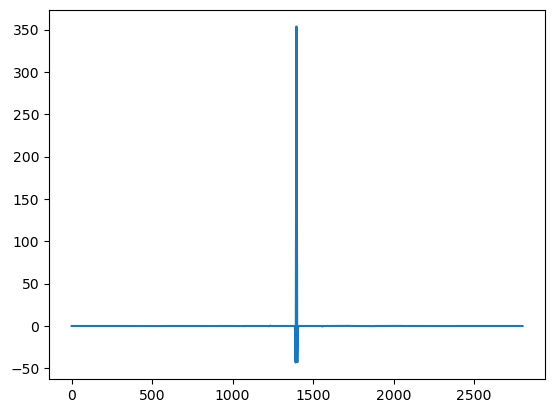

In [771]:
plt.plot(np.fft.fftshift(Ew))

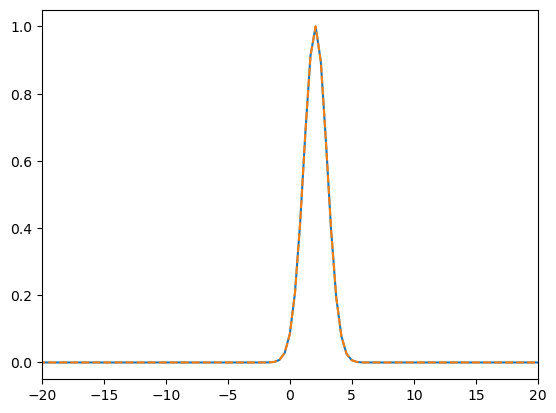

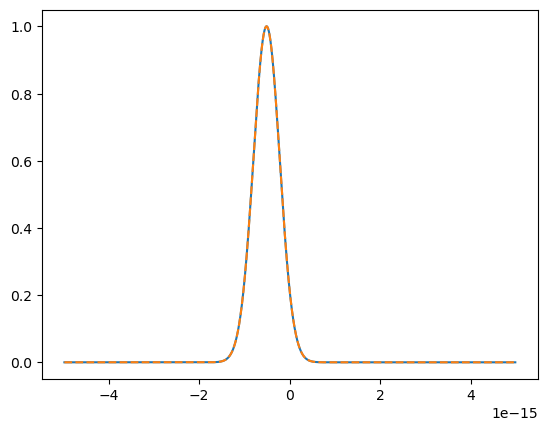

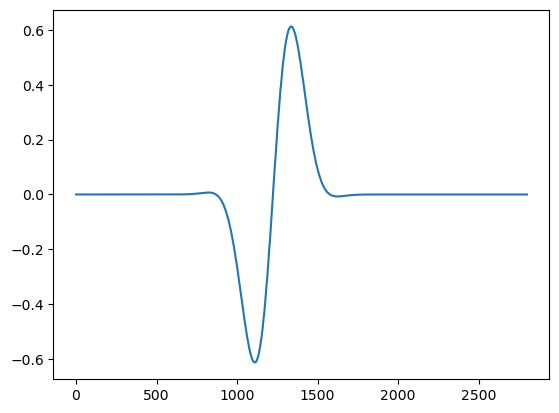

In [1042]:
Q = np.zeros((36,1), dtype = complex)
Q[14] = 1

spec =np.squeeze(np.matmul(Q.T,alphw))
xeV = eV
Et =np.squeeze(np.matmul(Q.T,alpha_t))
Ew = np.fft.ifftshift(np.fft.ifft(Et))
Et2 = np.fft.fft(np.fft.fftshift(spec))
plt.plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), label = 'vls, Ew')
plt.plot(eV, Ew*Ew.conj()/np.max(Ew*Ew.conj()), '--')
plt.xlim(-20,20)
plt.show()


plt.plot(vNaxis['t_sample'], Et*Et.conj()/np.max(np.abs(Et)**2), label = 'vls, Ew')
plt.plot(vNaxis['t_sample'], Et2*Et2.conj()/np.max(np.abs(Et2)**2), '--')
plt.show()

plt.plot(Et)



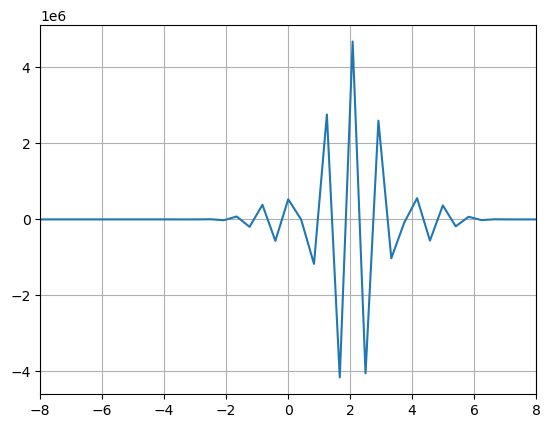

In [1048]:
plt.plot(eV,spec)
plt.xlim(-8,8)
plt.grid()

2801


/tmp/ipykernel_8289/1657492901.py:65: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_w.conj(),np.reshape(spec2,(2801,1))*2*np.pi*(xf[1]-xf[0])))[0]


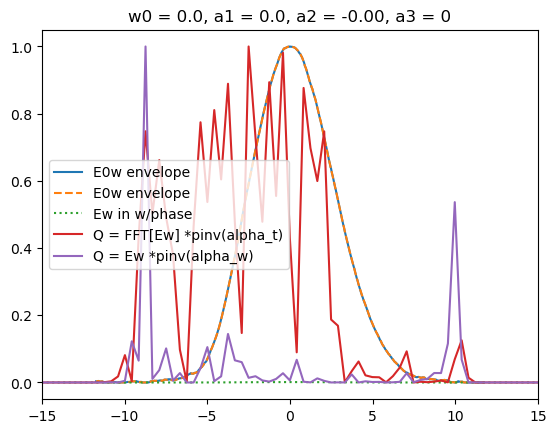

In [1552]:
ee = 0
a1 = 0.
a2 = -0.0
spec = np.sqrt(sss) #Ef0
pp =0 #1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))

N = len(spec)
xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
xeV = xeV + ee

n1 = 254 #40
n2 = -n1+1 #400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                #also need it to be centered around where you are calling zero or there will be an offset
# t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
# t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
xeV = xeV[n1:n2] 
spec = spec[n1:n2] 

plt.plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), label = 'E0w envelope')

f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
NN = 1024
fx = interpolate.interp1d(np.arange(len(xeV)), xeV, fill_value = 'extrapolate') #make sure f is evenly spaced
xeV = fx(np.linspace(0, len(xeV), NN))
spec = f(xeV)
plt.plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), '--', label = 'E0w envelope')

N = 2801
xf = np.arange(-N/2+1/2,N/2+1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0]))
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 
spec_at_w_sample = f(eV)
spec2 = spec_at_w_sample*np.exp(1j*(a1*(np.pi*2*(eV-ee))+a2*(np.pi*2*(eV-ee))**2))
plt.plot(eV, spec2*spec2.conj()/np.max(spec2*spec2.conj()),':', label = 'Ew in w/phase')

spec3 = np.copy(spec2)
spec3 = np.fft.fftshift(spec3)
f = xf[-1] - xf[0]
N = len(spec3)
print(N)
t = np.arange(-N/2+1/2,N/2+1/2,1)*1/f
FFT = np.fft.fftshift(np.fft.fft(spec3))

car3 = np.exp(-1.j*(ee)/hbar*t)
FFT = FFT*car3 #add in the frequency due to offset from zero frequency
f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
x = f(vNaxis['t_sample'])
alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

Q = np.reshape(np.matmul(np.reshape(x,(1,2801)), np.linalg.pinv(alpha_t)), [36,1])
Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
Msol1 = np.reshape(Msol1,[64,64])#, [int(np.sqrt(Msol1.shape[0])),int(np.sqrt(Msol1.shape[0]))]))

Ew = np.squeeze(np.matmul(Q.T,alphw))
EwEw = np.real(Ew*Ew.conj())
#EwEw = fastsmooth1(EwEw, 2)
EwEw = EwEw[1340:-1341]
EwEw = EwEw/np.max(EwEw)
plt.plot(eV[1340:-1341],EwEw,label = 'Q = FFT[Ew] *pinv(alpha_t)')


Q1 = np.reshape(np.matmul(np.reshape(spec2,(1,2801)), np.linalg.pinv(alpha_w)), [36,1])
#Q = np.reshape(np.matmul(np.array(spec_at_w_sample,dtype = complex), np.linalg.pinv(alpha_w)), [36,1])
#Q = np.matmul(np.linalg.pinv(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0])),np.matmul(alpha_w.conj(),np.reshape(spec_at_w_sample,(2801,1))*2*np.pi*(xf[1]-xf[0])))
Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_w.conj(),np.reshape(spec2,(2801,1))*2*np.pi*(xf[1]-xf[0])))[0]

Msol2=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
Msol2 = np.reshape(Msol2,[64,64])#, [int(np.sqrt(Msol1.shape[0])),int(np.sqrt(Msol1.shape[0]))]))

Ew = np.squeeze(np.matmul(Q.T,alpha_w))
EwEw = np.real(Ew*Ew.conj())
#EwEw = fastsmooth1(EwEw, 2)
EwEw = EwEw[1340:-1341]
EwEw = EwEw/np.max(EwEw)
plt.plot(eV[1340:-1341],EwEw, label = 'Q = Ew *pinv(alpha_w)')
plt.xlim(-15,15)
plt.legend()
plt.title('w0 = %1.1f, a1 = %1.1f, a2 = %1.2f, a3 = 0' %(ee,a1,a2))
plt.show()              

-21


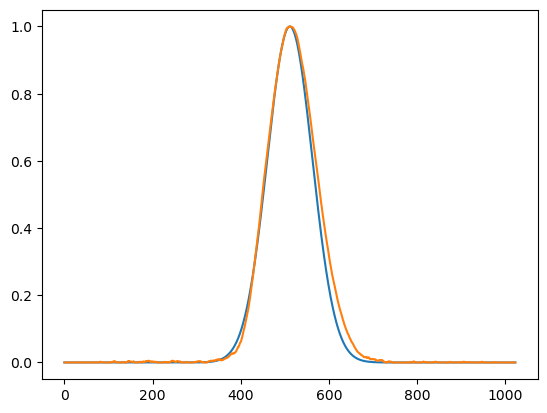

In [1606]:
x = np.linspace(-10,10,1024)
sig = 1
sss = (1/sig/np.sqrt(np.pi*2)*np.exp(-0.5*(x-0)**2/sig**2))
sss = sss/np.max(sss)
plt.plot(sss)
sss = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Feb3_110.npy')
sss = np.mean(sss,axis = 0)
sss = sss/np.max(sss)
sss[sss<0] = 0
rollnum = np.argmax(sss)-512
sss = np.roll(sss,-rollnum)
plt.plot(sss)
print(rollnum)

-15.727272727272728 7.727272727272728


NameError: name 'eV' is not defined

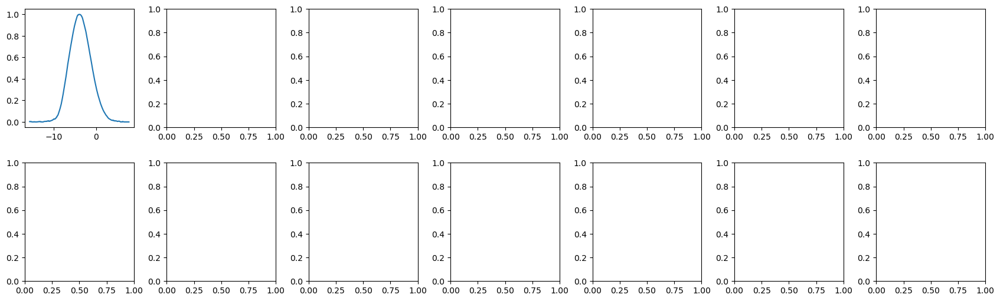

In [8]:
#check stuff
n = 7
ees = np.linspace(-4,4,n)
a1 = -0.5
a2 = -0.02#0.001
a3 = -0.00001 #0.0001

fig,axs = plt.subplots(nrows = 2, ncols = n, figsize =(n*3, 2*3))
plt.subplots_adjust(hspace = 0.3, wspace = 0.3)

for i in range(n):
    ee = ees[i]
    spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
    pp =0 #1200
    spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
    
    N = len(spec)
    xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
    xeV = xeV + ee

    n1 = 254 #40
    n2 = -n1+1 #400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                    #also need it to be centered around where you are calling zero or there will be an offset
    t1 = 0 # np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
    t2 = -1 #np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
    xeV = xeV[n1:n2] 
    spec = spec[n1:n2] 
    #spec = np.fft.fftshift(spec)

    axs[0][i].plot(xeV, np.real((spec)**2/np.max(spec**2)), label = 'vls, Ew')

    f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
    NN = 512*2
    NNN = 0
    N = len(spec)
    fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
    xeV = fx(np.linspace(0-NNN, N-1+NNN, NN))
    print(xeV[0],xeV[-1])
    spec = f(xeV)
    spec2 = f(eV)
    xf = 2.9979E8*xeV/1239.84e-9
    
    spec = (spec)*np.exp(1j*(a1*(np.pi*2*(xeV-ee))+a2*(np.pi*2*(xeV-ee))**2+a3*(np.pi*2*(xeV-ee))**3))
    spec2 = (spec2)*np.exp(1j*(a1*(np.pi*2*(eV-ee))+a2*(np.pi*2*(eV-ee))**2+a3*(np.pi*2*(eV-ee))**3))
    wphase = np.unwrap(np.angle(spec))
    wphase = wphase - np.mean(wphase)
    ax = axs[0][i].twinx()
    ax.plot(xeV,wphase*0.15, color = 'tab:blue')
    
    f = xf[-1] - xf[0]
    spec = np.fft.fftshift(spec)
    N = len(spec)
    t = np.linspace(-N/f/2+1/f/2,N/f/2+1/f/2, N) 
    FFT = np.fft.fftshift(np.fft.fft(spec))


    car3 = np.exp(-1.j*(ee)/hbar*t)
    FFT = FFT*car3 #add in the frequency due to offset from zero frequency
    f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
    x = f(vNaxis['t_sample'])
    alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

    Q = np.reshape(np.matmul(x, np.linalg.pinv(alpha_t)), [36,1])
    Q1 = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_t.conj(),np.reshape(x,(2801,1))*2*np.pi*(t[1]-t[0])))[0]
    Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))


    Et = np.squeeze(np.matmul(Q.T,alpha_t))
    f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    xf = np.arange(-N/2+1/2,N/2+1/2,1)/(ts[-1] - ts[0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), '--', label = 'Ew -> Et -> Q -> Et -> Ew')
    
    Et = np.squeeze(np.matmul(Q1.T,alpha_t))
    f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    xf = np.arange(-N/2+1/2,N/2+1/2,1)/(ts[-1] - ts[0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), ':', label = 'Ew -> Et -> Q -> Et -> Ew')
    aghh = np.argmax(np.abs(f(ts)))
    #aghh = 0 
    Ew = np.fft.ifftshift(np.fft.ifft(np.roll(f(ts),-aghh)))
    wphase = np.unwrap(np.angle(Ew))
    wphase = wphase - np.mean(wphase)
    ax.plot(xxeV,wphase, color = 'tab:green')
    
    

    axs[0][i].set_xlim(-15,15)
    axs[0][i].set_title('w0 = %1.1f' %ee)
    axs[0][i].grid()
    axs[0][i].set_xlabel('w [eV]')
    axs[1][i].pcolormesh((np.reshape(Msol1, [64,64])))
    axs[1][i].set_xticklabels([])
    axs[1][i].set_yticklabels([])
    ax.set_ylim(-60,60)

    r = 285 #360
    binn = 32/2
    phi_rad = np.arange(0,360)*np.pi/180
    axs[1][i].plot((512+r*np.cos(phi_rad))/binn, (512+r*np.sin(phi_rad))/binn, c='r')

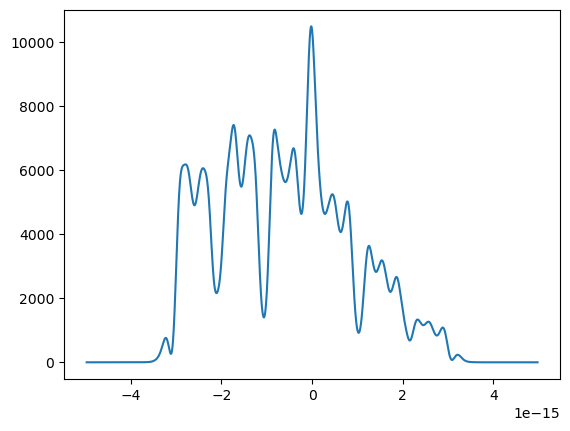

In [1600]:
plt.plot(vNaxis['t_sample'],np.abs(np.squeeze(np.matmul(Q.T, alpha_t)))**2)

In [1598]:
basesdir = '/reg/d/psdm/tmo/tmox51020/results/paris/circularpol_vNbases_dipole_K5/'
1239.84*(vNaxis['w_sample'][0])/2.9979E8/(2*np.pi)*1e-9,1239.84*(vNaxis['w_sample'][-1])/2.9979E8/(2*np.pi)*1e-9

(-11.736431718419107, 11.736431718419107)

In [1605]:
xxeV[0],xxeV[-1]

(-213.67757430201303, 213.67757430201303)

(-15.0, 15.0)

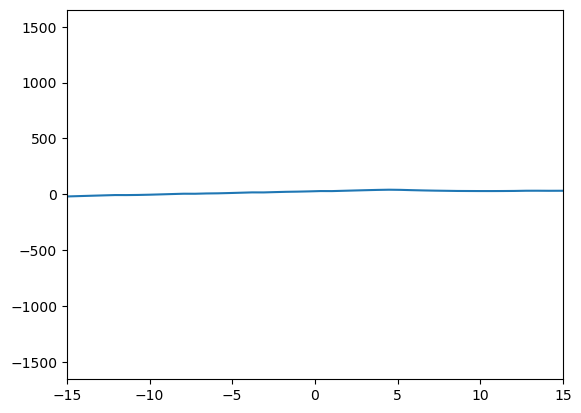

In [1427]:
wphase = np.unwrap(np.angle(Ew))
wphase = wphase - np.mean(wphase)
plt.plot(xxeV,wphase)
plt.xlim(-15,15)


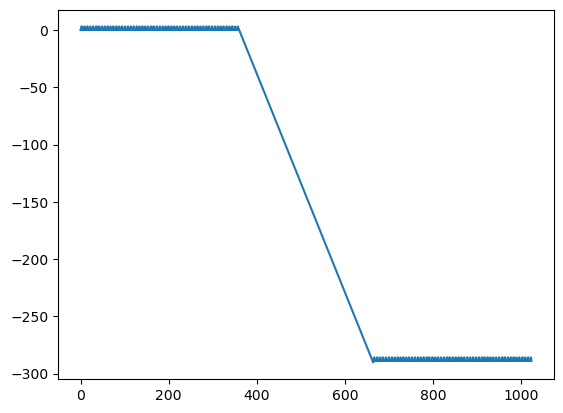

In [1401]:
plt.plot(np.unwrap(np.angle(spec22)))

(-25.0, 25.0)

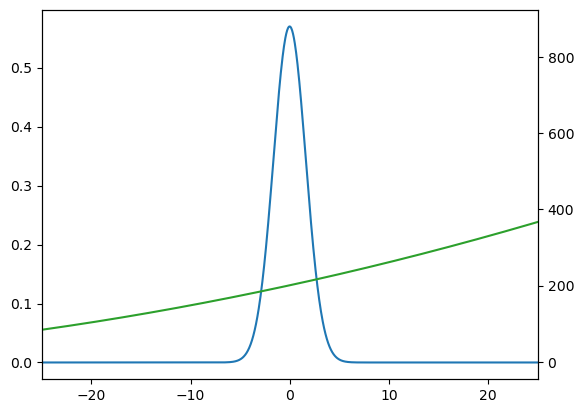

In [1399]:
a1 = 0.9
a2 = 0.001
spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
pp =1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
xeV = pix_2_eV(np.arange(len(spec)), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
xeV = xeV[n1:n2] 
spec = spec[n1:n2] 
xf = 2.9979E8*xeV/1239.84e-9
plt.plot(xeV,np.abs(spec*np.exp(1j*(a1*(np.pi*2*(xeV))+a2*(np.pi*2*(xeV))**2)))**2)
ax = plt.twinx()
ax.plot(xeV,np.unwrap(np.angle(np.exp(1j*(a1*(np.pi*2*(xeV))+a2*(np.pi*2*(xeV))**2)))), 'tab:green')
plt.xlim(-25,25)


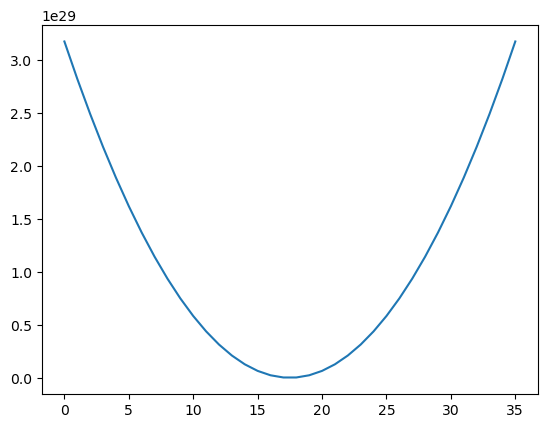

In [1393]:
a1 = 0
a2 = 0.001
plt.plot(a1*vNaxis['w']+a2*vNaxis['w']**2)

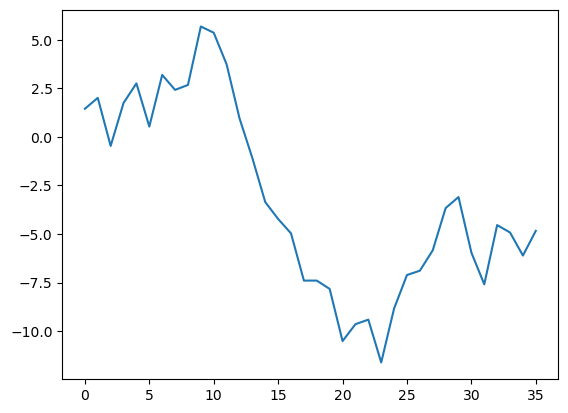

In [1390]:


plt.plot(np.unwrap(np.angle(np.exp(1j*(a1*vNaxis['w']+a2*vNaxis['w']**2)))))

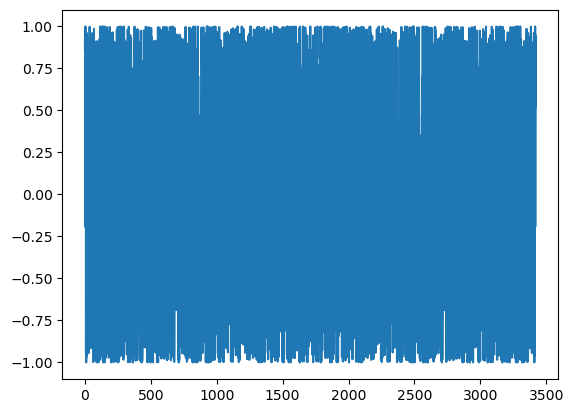

In [1339]:
plt.plot(np.real(np.exp(1j*(a1*(np.pi*2*(xf-f0))+a2*(np.pi*2*(xf-f0))**2))))

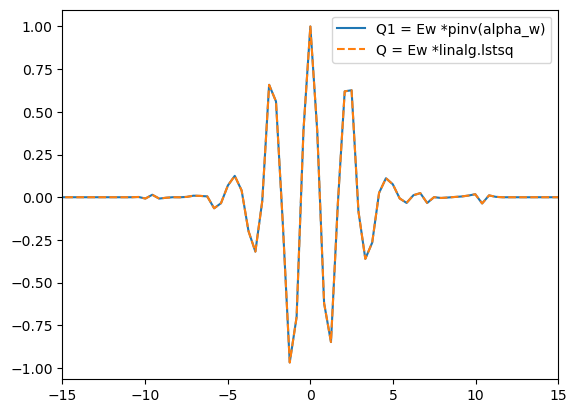

In [1167]:

Ew = np.squeeze(np.matmul(Q1.T,alpha_w))
Ew = Ew[1340:-1341]
Ew = Ew/np.max(Ew)
plt.plot(eV[1340:-1341],Ew, label = 'Q1 = Ew *pinv(alpha_w)')
plt.xlim(-15,15)
plt.legend()

Ew = np.squeeze(np.matmul(Q.T,alpha_w))
Ew = Ew[1340:-1341]
Ew = Ew/np.max(Ew)
plt.plot(eV[1340:-1341],Ew, '--', label = 'Q = Ew *linalg.lstsq')
plt.xlim(-15,15)
plt.legend()


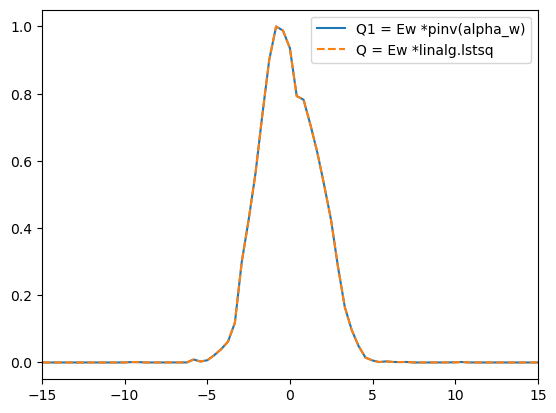

In [1162]:

Ew = np.squeeze(np.matmul(Q1.T,alpha_w))
EwEw = np.real(Ew*Ew.conj())
#EwEw = fastsmooth1(EwEw, 2)
EwEw = EwEw[1340:-1341]
EwEw = EwEw/np.max(EwEw)
plt.plot(eV[1340:-1341],EwEw, label = 'Q1 = Ew *pinv(alpha_w)')
plt.xlim(-15,15)
plt.legend()

Ew = np.squeeze(np.matmul(Q.T,alpha_w))
EwEw = np.real(Ew*Ew.conj())
#EwEw = fastsmooth1(EwEw, 2)
EwEw = EwEw[1340:-1341]
EwEw = EwEw/np.max(EwEw)
plt.plot(eV[1340:-1341],EwEw, '--', label = 'Q = Ew *linalg.lstsq')
plt.xlim(-15,15)
plt.legend()


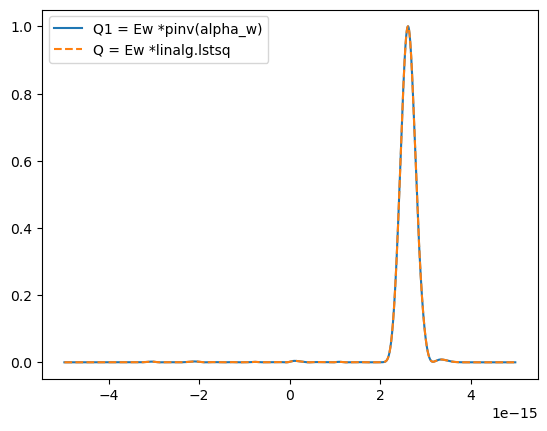

In [1171]:
Et = np.squeeze(np.matmul(Q1.T,alpha_t))
EtEt = np.real(Et*Et.conj())
#EwEw = fastsmooth1(EwEw, 2)
EtEt = EtEt/np.max(EtEt)
plt.plot(vNaxis['t_sample'],EtEt, label = 'Q1 = Ew *pinv(alpha_w)')

plt.legend()

Ew = np.squeeze(np.matmul(Q.T,alpha_t))
EtEt = np.real(Et*Et.conj())
#EwEw = fastsmooth1(EwEw, 2)
EtEt = EtEt/np.max(EtEt)
plt.plot(vNaxis['t_sample'],EtEt, '--', label = 'Q = Ew *linalg.lstsq')

plt.legend()


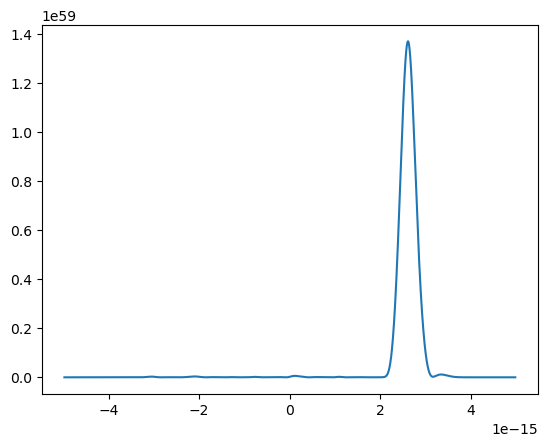

In [1091]:
plt.plot(vNaxis['t_sample'], np.abs(np.squeeze(np.matmul(Q.T,alpha_t)))**2)
#plt.xlim(-3.08e-15,3.08e-15)

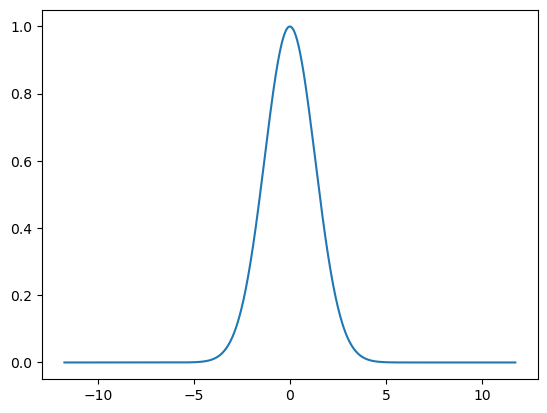

In [1150]:
plt.plot(1239.84*(vNaxis['w_sample'])/2.9979E8/(2*np.pi)*1e-9 ,np.exp(-((vNaxis['w_sample']))**2/(2 * 2e15**2)))

In [1173]:
ws = 2*np.pi*xf
Ef0=np.exp(-((ws))**2/(2 * 2e15**2))
Ef=Ef0*np.exp(1j*(a1*(ws)+a2*(ws**2))) 

Op = np.matmul(alpha_w, Ef) *(ws[1]-ws[0])

Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),Op)[0]
Q = np.reshape(Q, (36,1))

/tmp/ipykernel_8289/2287845081.py:7: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  Q = np.linalg.lstsq(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),Op)[0]


(-10.0, 10.0)

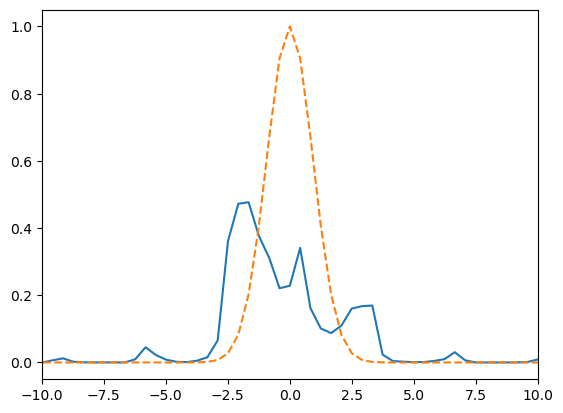

In [1184]:
plt.plot(1239.84*(ws)/2.9979E8/(2*np.pi)*1e-9, np.abs(np.squeeze(np.matmul(Q.T, alpha_w)))**2/1e59)
plt.plot(1239.84*(ws)/2.9979E8/(2*np.pi)*1e-9,Ef*Ef.conj(), '--')
plt.xlim(-10,10)

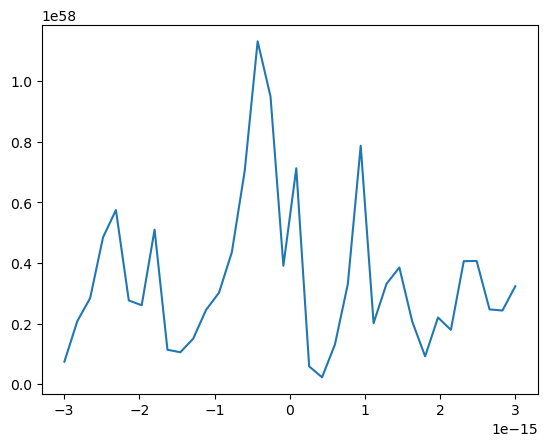

In [1149]:
plt.plot(vNaxis['t'], np.abs(np.squeeze(np.matmul(Q.T, alpha['t'])))**2)

In [1092]:
1.85e-6/3e8/2

3.0833333333333335e-15

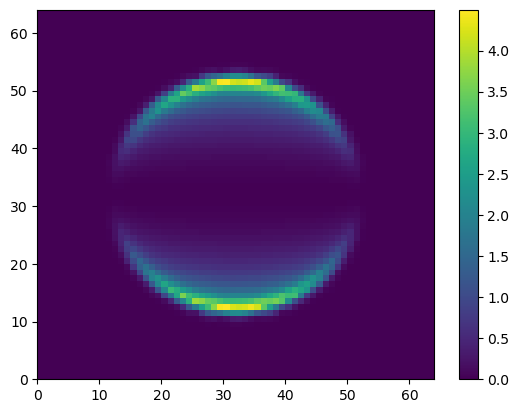

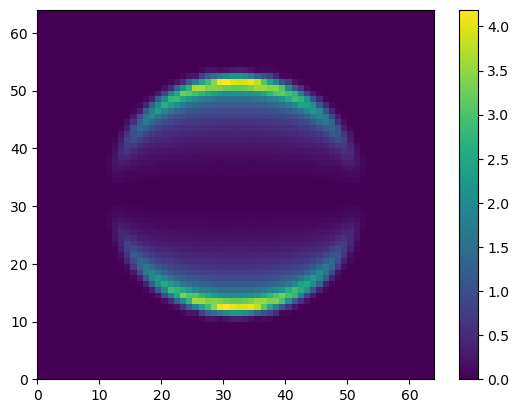

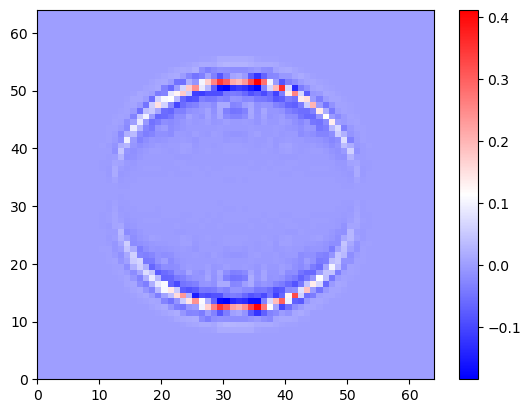

In [1093]:
plt.pcolormesh(Msol1/np.sum(Msol1)*1000)
plt.colorbar()
plt.show()
plt.pcolormesh(Msol2/np.sum(Msol2)*1000)
plt.colorbar()
plt.show()
plt.pcolormesh(Msol1/np.sum(Msol1)*1000-Msol2/np.sum(Msol2)*1000, cmap ='bwr')
plt.colorbar()
plt.show()

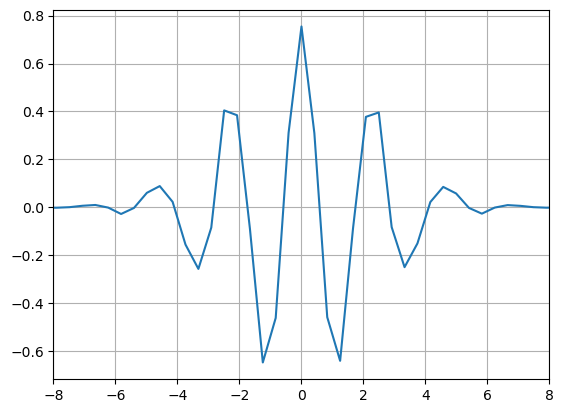

In [1100]:
plt.plot(eV,spec2)
plt.xlim(-8,8)
plt.grid()

(-15.0, 15.0)

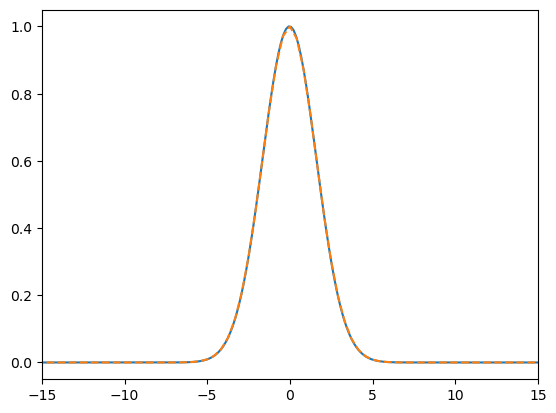

In [1041]:
plt.plot(xeV,spec*spec.conj()/np.max(spec*spec.conj()))
plt.plot(eV,spec2*spec2.conj()/np.max(spec2*spec2.conj()), '--')
plt.xlim(-15,15)

In [839]:
print(len(car3))

1024


-84.81818181818183 70.86363636363637
-82.4848484848485 73.1969696969697
-80.15151515151516 75.53030303030305
-77.81818181818183 77.86363636363637
-75.4848484848485 80.1969696969697
-73.15151515151516 82.53030303030305
-70.81818181818183 84.86363636363637


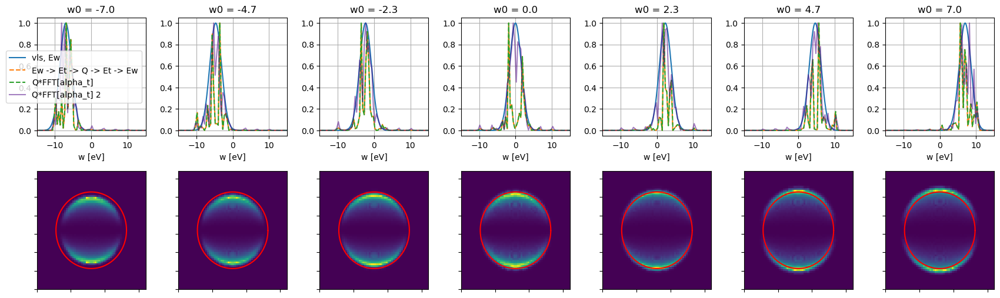

In [822]:
#check stuff
energy_x = 36
n = 7
ees = np.linspace(-7,7,n)

sss[sss<0] = 0

fig,axs = plt.subplots(nrows = 2, ncols = n, figsize =(n*3, 2*3))
plt.subplots_adjust(hspace = 0.3, wspace = 0.3)

for i in range(n):
    ee = ees[i]
    
#     Q = np.zeros((36,1), dtype = complex)
#     Q[14] = 1
#     Q[15] = 0.4j
#     Q[2] = -0.1j
#     spec =np.squeeze(np.matmul(Q.T,alphw))
#     xeV = eV
    spec = np.sqrt(sss) #Ef0
    pp =1200
    spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
    N = len(spec)
    xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
    xeV = xeV + ee

    #n1 = 0
    #n2 = 3400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                    #also need it to be centered around where you are calling zero or there will be an offset
    # t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
    # t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
    # xeV = xeV[n1:n2] 
    # spec = spec[n1:n2] 

    axs[0][i].plot(xeV, spec*spec.conj()/np.max(spec*spec.conj()), label = 'vls, Ew')

    f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
    NN = 512*2
    N = len(spec)
    fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
    #xeV = fx(np.linspace(0-NNN, N-1+NNN, NN))
    xeV = fx(np.linspace(0, N+1, NN))
    print(xeV[0],xeV[-1])
    spec = f(xeV)
    spec = np.fft.fftshift(spec)
    spec_at_w_sample = f(np.linspace(xxeV[0],xxeV[-1], 2801))
    spec2 = spec_at_w_sample*np.exp(1j*(-.7*(np.pi*2*xf)))
    f3 = interpolate.interp1d(np.linspace(xxeV[0],xxeV[-1], 2801), spec2, fill_value = 'extrapolate')
    spec3 = np.fft.fftshift(f3(xeV))
    xf = 2.9979E8*xeV/1239.84e-9

    f = xf[-1] - xf[0]
    N = len(spec)
    t = np.arange(-N/2,N/2,1)*1/f
    FFT = np.fft.fftshift(np.fft.fft(spec3))


    car3 = np.exp(-1.j*(ee)/hbar*t)
    FFT = FFT*car3 #add in the frequency due to offset from zero frequency
    f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
    x = f(vNaxis['t_sample'])
    alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

    Q = np.reshape(np.matmul(np.reshape(x,(1,2801)), np.linalg.pinv(alpha_t)), [36,1])
    Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))


    Et = np.squeeze(np.matmul(Q.T,alpha_t))
    #f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    #ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    #st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    st = np.fft.ifftshift(np.fft.ifft(Et))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    #xf = np.arange(-N/2,N/2,1)/(ts[-1]-ts[0])
    xf = np.arange(-len(Et)/2,len(Et)/2,1)/(vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), '--', label = 'Ew -> Et -> Q -> Et -> Ew')
    axs[0][i].set_xlim(-15,15)
    axs[0][i].set_title('w0 = %1.1f' %ee)
    axs[0][i].grid()
    axs[0][i].set_xlabel('w [eV]')
    axs[1][i].pcolormesh((np.reshape(Msol1, [64,64])))
    axs[1][i].set_xticklabels([])
    axs[1][i].set_yticklabels([])

    r = 332 #285 #360
    binn = 32/2
    phi_rad = np.arange(0,360)*np.pi/180
    axs[1][i].plot((512+r*np.cos(phi_rad))/binn, (512+r*np.sin(phi_rad))/binn, c='r')
    
    Ew = np.squeeze(np.matmul(Q.T,alphw))
    EwEw = np.real(Ew*Ew.conj())
    EwEw = EwEw[1340:-1341]
    EwEw = EwEw/np.max(EwEw)
    axs[0][i].plot(np.linspace(eV[1340],eV[-1341], len(EwEw)), np.squeeze(EwEw), 'tab:green', linestyle = '--', label = 'Q*FFT[alpha_t]')
    #axs[0][i].plot(eV, np.squeeze(EwEw), 'tab:green', label = 'Q*FFT[alpha_t]')
    
    #Q = np.reshape(np.matmul(np.reshape(np.array(spec_at_w_sample,dtype = complex),(1,2801)), np.linalg.pinv(alpha_w)), [36,1])
    Q = np.reshape(np.matmul(np.reshape(np.array(spec2,dtype = complex),(1,2801)), np.linalg.pinv(alpha_w)), [36,1])
    #Q = np.reshape(np.matmul(np.array(spec_at_w_sample,dtype = complex), np.linalg.pinv(alpha_w)), [36,1])
    #Q = np.matmul(np.matmul(alpha_t.conj(),alpha_t.T)*(vNaxis['t_sample'][1] - vNaxis['t_sample'][0]),np.matmul(alpha_w.conj(),np.reshape(spec_at_w_sample,(2801,1))*2*np.pi*(xf[1]-xf[0])))
    
    Ew = np.squeeze(np.matmul(Q.T,alphw))
    EwEw = np.real(Ew*Ew.conj())
    #EwEw = fastsmooth1(EwEw, 2)
    EwEw = EwEw[1340:-1341]
    EwEw = EwEw/np.max(EwEw)
    axs[0][i].plot(np.linspace(eV[1340],eV[-1341], len(EwEw)), np.squeeze(EwEw), 'indigo', label = 'Q*FFT[alpha_t] 2', alpha = 0.5)
    
axs[0][0].legend()

In [790]:
np.linalg.pinv(alpha_t).shape

(2801, 36)

In [ ]:
np.reshape(spec_at_w_sample,(2801,1)

0
3424


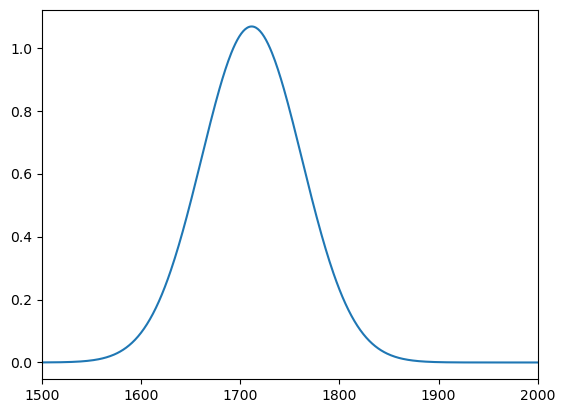

1024
-77.81818181818183 76.68181818181819


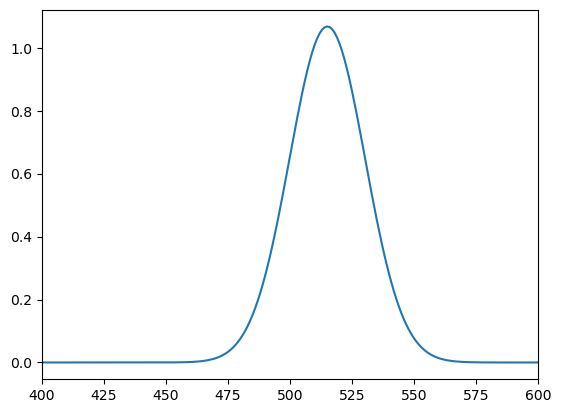

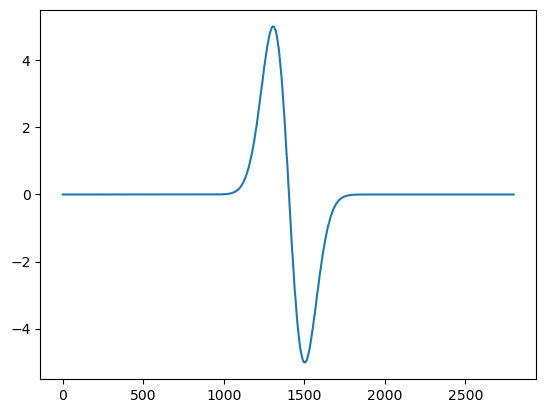

In [614]:
ee = 0
print(ee)
spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
pp =1200
spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
N = len(spec)
xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
xeV = xeV + ee
print(len(xeV))
#n1 = 0
#n2 = 3400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                #also need it to be centered around where you are calling zero or there will be an offset
t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
xeV = xeV[n1:n2] 
spec = spec[n1:n2] 
plt.plot(spec)
plt.xlim(1500,2000)
plt.show()



axs[0][i].plot(xeV, np.real(np.fft.ifftshift(spec)**2/np.max(spec**2)), label = 'vls, Ew')

f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
NN = 512*2
N = len(spec)
fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
#xeV = fx(np.linspace(0-NNN, N-1+NNN, NN))
xeV = fx(np.linspace(0, N-1, NN))
print(len(xeV))
print(xeV[0],xeV[-1])
spec = f(xeV)
spec = np.fft.fftshift(spec)
plt.plot(np.fft.fftshift(spec))
plt.xlim(400,600)
plt.show()
spec_at_w_sample = f(np.linspace(xxeV[0],xxeV[-1], 2801))
xf = 2.9979E8*xeV/1239.84e-9

f = xf[-1] - xf[0]
N = len(spec)
t = np.arange(-N/2+1/2,N/2+1/2,1)*1/f
FFT = np.fft.fftshift(np.fft.fft(spec))


car3 = np.exp(-1.j*(ee)/hbar*t)
FFT = FFT*car3 #add in the frequency due to offset from zero frequency
f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
x = f(vNaxis['t_sample'])
plt.plot(np.imag(x))

In [615]:
spec

array([1.04558051, 1.05738042, 1.06476188, ..., 0.98511602, 1.0091901 ,
       1.02944817])

In [616]:
np.imag(spec - np.fft.ifft(np.fft.fft(spec)))

array([ 6.39679282e-18,  1.21972744e-17, -1.80248611e-18, ...,
        1.55311961e-17, -6.68139589e-17, -6.06069014e-17])

In [623]:
alpha_w = alphw/np.max(np.abs(alphw)) 
np.linalg.pinv(alpha_w)

array([[-7.75927755e-07+8.71275496e-08j,  6.90362444e-08+7.65661125e-07j,
         1.33780650e-06+4.16057771e-07j, ...,
        -6.64351643e-07+1.37869015e-06j, -5.20546018e-07-2.08043533e-07j,
         4.63560367e-07-4.21745523e-07j],
       [-4.64033107e-07+4.21225331e-07j,  5.20312351e-07+2.08627244e-07j,
         6.65897564e-07-1.37794415e-06j, ...,
        -1.33733901e-06-4.17557985e-07j, -6.81774357e-08-7.65738072e-07j,
         7.76024988e-07-8.62572187e-08j],
       [ 3.51608171e-07+8.97796521e-07j,  1.01941689e-06+2.02457233e-07j,
        -7.27781823e-07-4.49514798e-07j, ...,
        -4.98440072e-08-7.61589475e-07j,  8.49329364e-07-1.28442210e-07j,
         1.08084418e-06+9.06024365e-07j],
       ...,
       [ 3.35986174e-06-2.94286291e-06j,  2.82016441e-07-1.91724567e-06j,
        -8.30061414e-07-5.18182065e-07j, ...,
         5.13671073e-07-1.90128663e-07j,  1.20137819e-06+1.72178976e-06j,
        -4.51797323e-07+8.54244416e-07j],
       [-2.10058461e-07-2.35595960e-06j, -8.

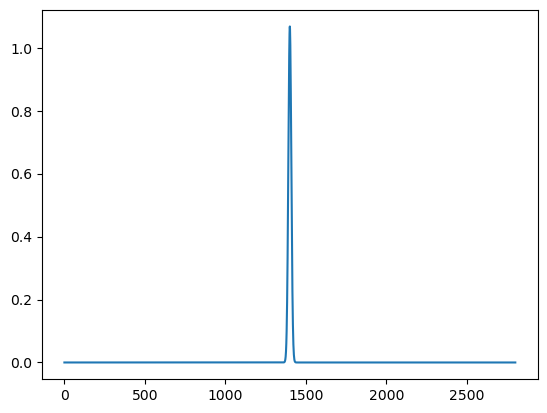

In [620]:
plt.plot(spec_at_w_sample)

In [624]:
Q = np.reshape(np.matmul(np.array(spec_at_w_sample,dtype = complex), np.linalg.pinv(alpha_w)), [36,1])

In [625]:
Q

array([[-1.04708197e-03+0.00021377j],
       [-1.01243220e-03+0.00197109j],
       [ 2.22059994e-03+0.00240594j],
       [ 2.96199139e-03-0.00172865j],
       [-5.80017242e-04-0.00246465j],
       [-1.19491300e-03-0.0004494j ],
       [ 2.78025822e-04-0.00039006j],
       [ 4.12608534e-05-0.00086271j],
       [-7.83770252e-04-0.00066534j],
       [-9.31237059e-04+0.00045909j],
       [-1.20967027e-04+0.00091368j],
       [ 2.51037824e-04+0.00047337j],
       [-4.02043780e-05+0.00029427j],
       [ 3.23760317e-05+0.00046343j],
       [ 2.01209281e-04+0.00028454j],
       [ 2.22470126e-04-0.00018919j],
       [ 7.20792260e-05-0.00044094j],
       [-2.41964425e-05-0.00031502j],
       [-3.92762561e-05-0.00029284j],
       [ 3.01547799e-05-0.00046036j],
       [ 1.92571295e-04-0.00028238j],
       [ 2.13744559e-04+0.00018676j],
       [ 7.03656765e-05+0.00043715j],
       [-2.22001858e-05+0.00031321j],
       [ 2.72266069e-04+0.00038791j],
       [ 3.78399722e-05+0.00085027j],
       [-7.6

In [552]:
try from simple Q = [0,1,0,0]

array([-26.7398826 +0.j, -26.71506136+0.j, -26.69024012+0.j, ...,
        32.02072251+0.j,  32.04978341+0.j,  32.0788443 +0.j])

In [541]:
eV[1340],eV[-1341]

(-24.93886424014417, 24.93886424014417)

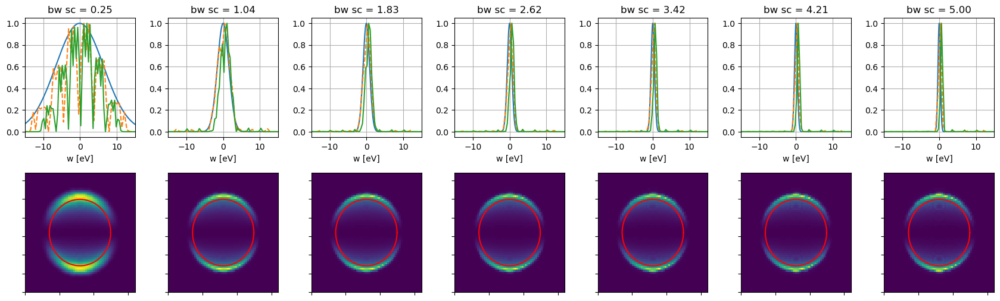

In [546]:
#check stuff
energy_x = 36
n = 7
scales = np.linspace(0.25, 5, n)
ee = 0
sss[sss<0] = 0

check_ims = []

N = 2801
xf = np.arange(-N/2-1/2,N/2-1/2,1)/((vNaxis['t_sample'][-1] - vNaxis['t_sample'][0])) #using tsample range
eV = 1239.84*(2*np.pi*xf)/2.9979E8/(2*np.pi)*1e-9 

fig,axs = plt.subplots(nrows = 2, ncols = n, figsize =(n*3, 2*3))
plt.subplots_adjust(hspace = 0.3, wspace = 0.3)

for i in range(n):
    ee = 0
    spec = np.sqrt(sss)  #sqrt of intensity spectra to get E(w)
    
    x1 = np.arange(len(sss))
    f = interpolate.interp1d(x1, spec, fill_value = 0, bounds_error = False)
    sc = scales[i] #3.5/5
    xs = np.linspace(sc*(x1[0] -len(sss)/2), sc*(x1[-1]-len(sss)/2), len(x1))+len(sss)/2
    spec = f(xs)
    #spec_at_w_sample = f(xxeV
    
    pp =1200
    spec = np.pad(spec, (pp,), 'constant',constant_values=(0))
    N = len(spec)
    xeV = pix_2_eV(np.arange(N), pixpereV = 22, spectra_hw0 = 0, spectra_pix0 = pp+512)
    xeV = xeV + ee

    n1 = 0
    n2 = 3400 #want this to span 33.40369027550054 eV or less (range of vNaxis['w'])
                    #also need it to be centered around where you are calling zero or there will be an offset
    t1 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][0])**2) #772
    t2 = np.argmin((vNaxis['t_sample'] -vNaxis['t'][-1])**2)#4828 [386:2414]
    xeV = xeV[n1:n2] 
    spec = spec[n1:n2] 
    xeV1 = np.copy(xeV)
    spec1 = np.copy(spec)
    spec = np.fft.fftshift(spec)


    axs[0][i].plot(xeV, np.real(np.fft.ifftshift(spec)**2/np.max(spec**2)), label = 'vls, Ew')

    f = interpolate.interp1d(xeV, spec, fill_value = 'extrapolate')
    NN = 512*2
    NNN = 0
    N = len(spec)
    fx = interpolate.interp1d(np.arange(N), xeV, fill_value = 'extrapolate')
    xeV = fx(np.linspace(0-NNN, N-1+NNN, NN))
    spec = f(xeV)
    xf = 2.9979E8*xeV/1239.84e-9

    f = xf[-1] - xf[0]
    N = len(spec)
    t = np.linspace(-N/f/2-1/f/2,N/f/2-1/f/2, N) 
    FFT = np.fft.fftshift(np.fft.fft(spec))


    car3 = np.exp(-1.j*(ee)/hbar*t)
    FFT = FFT*car3 #add in the frequency due to offset from zero frequency
    f = interpolate.interp1d(t, FFT, fill_value = 'extrapolate')
    x = f(vNaxis['t_sample'])
    alpha_t = alpha['t_sample']/np.max(np.abs(alpha['t_sample'])) #since we have shifted to right off zero frequency, do not add carrier to alpha

    Q = np.reshape(np.matmul(x, np.linalg.pinv(alpha_t)), [36,1])
    Msol1=np.real(np.matmul(np.matmul(Q,Q.conj().transpose()).transpose().flatten(),Bp_basis))
    

    Et = np.squeeze(np.matmul(Q.T,alpha_t))
    f = interpolate.interp1d(vNaxis['t_sample'], Et, fill_value = 'extrapolate') #take out offset you put in before solving Q
    ts = np.linspace(vNaxis['t_sample'][t1:t2][0],vNaxis['t_sample'][t1:t2][-1], N)
    st = np.fft.ifftshift(np.fft.ifft(f(ts)))
    specc = st*np.conj(st)
    specc = specc/np.max(np.abs(specc))

    xf = np.arange(-N/2-1/2,N/2-1/2,1)/(ts[-1] - ts[0])  #Hz???
    xxeV = 1239.84*(xf*2*np.pi)/2.9979E8/(2*np.pi)*1e-9

    axs[0][i].plot(xxeV, np.real(st*np.conj(st))/np.max(np.real(st*np.conj(st))), '--', label = 'Ew -> Et -> Q -> Et -> Ew')
    axs[0][i].set_xlim(-15,15)
    axs[0][i].set_title('bw sc = %1.2f' %sc)
    axs[0][i].grid()
    axs[0][i].set_xlabel('w [eV]')
    axs[1][i].pcolormesh((np.reshape(Msol1, [64,64])))
    check_ims.append(np.reshape(Msol1, [64,64]))
    axs[1][i].set_xticklabels([])
    axs[1][i].set_yticklabels([])
    
    Ew = np.squeeze(np.matmul(Q.T,alphw))
    EwEw = np.real(Ew*Ew.conj())
    EwEw = EwEw[1340:-1340]
    EwEw = EwEw/np.max(EwEw)
    axs[0][i].plot(np.linspace(eV[1340],eV[-1340], len(EwEw)), np.squeeze(EwEw), 'tab:green')
    
    
    
#     spec_in = spec1
#     f = interpolate.interp1d(xeV1, spec_in, fill_value = 0, bounds_error= False) #take out offset you put in before solving Q
#     Q = np.reshape(np.matmul(np.reshape(f(eV),[1,2801]), np.linalg.pinv(alphw)), [36,1])
#     Ew = np.squeeze(np.matmul(Q.T,alphw))
#     EwEw = np.real(Ew*Ew.conj())
#     EwEw = EwEw[1340:-1340]
#     EwEw = EwEw/np.max(EwEw)
#     axs[0][i].plot(np.linspace(eV[1340],eV[-1340], len(EwEw)), np.squeeze(EwEw), 'r')
    

    r = 285 #360
    binn = 32/2
    phi_rad = np.arange(0,360)*np.pi/180
    axs[1][i].plot((512+r*np.cos(phi_rad))/binn, (512+r*np.sin(phi_rad))/binn, c='r')